# Image Classification

# EDA + Preprocessing


## Def

In [7]:
# --- Imports from all files ---
import torch
from torch import nn
import torchvision
from torchvision import models, datasets, transforms
import timm
import kornia
from kornia.losses import FocalLoss

import yaml
import logging
from datetime import datetime
from pathlib import Path
import time
import pickle
import os
import inspect
import argparse # For running predict/explain

# Math, CV, and Plotting
import numpy as np
import cv2
import matplotlib.pyplot as plt
import pandas as pd

# DataLoading
from torch.utils.data import DataLoader, Dataset
from PIL import Image

# Augmentations
import albumentations as A
from albumentations.pytorch import ToTensorV2
from albumentations.core.transforms_interface import ImageOnlyTransform

# TQDM
from tqdm.auto import tqdm # .auto works in both console and notebook

# Metrics and XAI
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from captum.attr import IntegratedGradients
from captum.attr import visualization as viz

# Typing
from typing import Sequence, Optional, Dict, Any, List, Callable, Tuple

import wandb

## Install & Import 

In [2]:
import os, random, math, glob
from collections import Counter, defaultdict
import numpy as np
import pandas as pd
from PIL import Image, ImageOps, ImageFilter, ImageEnhance
import matplotlib.pyplot as plt
from IPython.display import display

### Load Dataset

In [3]:
INPUT_DIR = 'data/histopathologic-oral-cancer'
WORKING_DIR = '/kaggle/working'

## Exploratory Data Analysis

### CONFIG_EDA & Setting Up

In [4]:
CONFIG_EDA = {
    "label_format": "folder",           # "folder" | "csv"
    "image_root": f'{INPUT_DIR}/train',    # Top-level folder containing class subfolders (for "folder" mode)
    "csv_path": None,  # Only used if label_format == "csv"
    "label_col": None,               # Only used if label_format == "csv"
    "image_col": None, # "filepath",            # Column with full/relative paths; if None, use id_col + image_suffix
    "id_col": None,                     # Used only when image_col is None
    "image_suffix": "",# ".jpg",             # Used only when building path from id_col
    "train_subdir": "train",  # Add these to handle train/test folders
    "test_subdir": "test",
    "class_map": None,                  # Optional: e.g., {0: "cat", 1: "dog"}
    "valid_exts": [".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff"],
    "glob_pattern": "**/*",             # For folder mode: which files to scan
    "seed": 42,

    # Viz tuning
    "sample_per_class": 8,              # Images per class in the sample grid
    "hist_max_images_per_class": 50,    # Max images per class for histogram aggregation
    "img_resize_for_hist": 256,         # Resize shorter side to this (speed). None to disable
    "normalize_hist": False,            # True -> plot probability density; False -> counts
}

print("✅ Edit CONFIG_EDA above, then run all cells below.")

✅ Edit CONFIG_EDA above, then run all cells below.


### Declaration & Utils

In [5]:
random.seed(CONFIG_EDA["seed"])
np.random.seed(CONFIG_EDA["seed"])

def _is_image(p, exts):
    p_low = p.lower()
    return any(p_low.endswith(e) for e in exts)

def _collect_from_folder(root, valid_exts, glob_pattern="**/*"):
    paths = [p for p in glob.glob(os.path.join(root, glob_pattern), recursive=True) if _is_image(p, valid_exts)]
    data = []
    for p in paths:
        rel = os.path.relpath(p, root)
        parts = rel.split(os.sep)
        if len(parts) < 2:
            continue  # needs class subfolder
        label = parts[0]
        data.append((p, label))
    return data

def _collect_from_csv(csv_path, image_root, label_col, image_col=None, id_col=None, image_suffix=".jpg"):
    df = pd.read_csv(csv_path)
    if image_col is None:
        if id_col is None:
            raise ValueError("Provide image_col or id_col in CONFIG_EDA for csv mode.")
        df["__image_path"] = df[id_col].astype(str) + image_suffix

    def join_path(p):
        if os.path.isabs(p):
            return p
        # Try both train and test folders
        train_path = os.path.join(image_root, CONFIG_EDA["train_subdir"], p)
        test_path = os.path.join(image_root, CONFIG_EDA["test_subdir"], p)
        
        if os.path.exists(train_path):
            return train_path
        if os.path.exists(test_path):
            return test_path
            
        # Fallback to direct join if not found in train/test
        return os.path.join(image_root, p)

    paths = df["__image_path"].map(join_path).tolist()
    labels = df[label_col].tolist()
    return list(zip(paths, labels))

def _apply_class_map(data, class_map):
    if class_map is None:
        return data
    return [(p, class_map.get(lbl, lbl)) for p, lbl in data]

def load_dataset():
    fmt = CONFIG_EDA["label_format"].lower()
    if fmt == "folder":
        data = _collect_from_folder(CONFIG_EDA["image_root"], CONFIG_EDA["valid_exts"], CONFIG_EDA["glob_pattern"])
    elif fmt == "csv":
        data = _collect_from_csv(
            CONFIG_EDA["csv_path"], CONFIG_EDA["image_root"], CONFIG_EDA["label_col"],
            image_col=CONFIG_EDA.get("image_col"),
            id_col=CONFIG_EDA.get("id_col"),
            image_suffix=CONFIG_EDA.get("image_suffix", ".jpg"),
        )
    else:
        raise ValueError("Unsupported label_format. Use 'folder' or 'csv'.")
    data = _apply_class_map(data, CONFIG_EDA.get("class_map"))
    data = [(p, y) for p, y in data if os.path.isfile(p)]  # keep only existing files
    return data

def pil_open_rgb(path):
    with Image.open(path) as im:
        im = im.convert("RGB")
        s = CONFIG_EDA["img_resize_for_hist"]
        if s:
            w, h = im.size
            if min(w, h) > s:
                if w <= h:
                    new_w = s
                    new_h = int(h * (s / w))
                else:
                    new_h = s
                    new_w = int(w * (s / h))
                im = im.resize((new_w, new_h), Image.LANCZOS)
        return np.array(im)

def plot_image_grid(samples, title="sample images"):
    n = len(samples)
    if n == 0:
        print("No samples to display.")
        return
    cols = min(8, max(2, int(math.sqrt(n))))
    rows = math.ceil(n/cols)
    plt.figure(figsize=(cols*2.2, rows*2.2))
    for i, (p, y) in enumerate(samples):
        try:
            arr = pil_open_rgb(p)
        except Exception:
            continue
        ax = plt.subplot(rows, cols, i+1)
        ax.imshow(arr)
        ax.set_title(str(y), fontsize=9)
        ax.axis("off")
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

def plot_class_distribution(labels, title="class distribution"):
    counts = Counter(labels)
    classes = list(counts.keys())
    vals = [counts[c] for c in classes]
    plt.figure(figsize=(8,4))
    plt.bar(range(len(classes)), vals)
    plt.xticks(range(len(classes)), classes, rotation=45, ha="right")
    plt.ylabel("count")
    plt.title(title)
    plt.tight_layout()
    plt.show()

def compute_rgb_hist(arr):
    # arr: HxWx3 uint8
    hists = []
    for ch in range(3):
        hist, _ = np.histogram(arr[..., ch].ravel(), bins=256, range=(0,256),
                               density=CONFIG_EDA["normalize_hist"])
        hists.append(hist)
    return hists  # [R, G, B]

def plot_per_class_histograms(data_by_class):
    # One figure per class. Log y to mimic your reference look.
    for cls, paths in data_by_class.items():
        k = min(len(paths), int(CONFIG_EDA["hist_max_images_per_class"]))
        sel = random.sample(paths, k) if k > 0 else []
        if not sel:
            print(f"[{cls}] no images to plot.")
            continue

        agg = np.zeros((3, 256), dtype=float)
        total = 0
        for p in sel:
            try:
                arr = pil_open_rgb(p)
            except Exception:
                continue
            hists = compute_rgb_hist(arr)
            agg += np.stack(hists, axis=0)
            total += 1

        if total == 0:
            print(f"[{cls}] failed to load images for histogram.")
            continue

        agg = agg / total  # average per channel
        plt.figure(figsize=(7,4))
        # three channels overlaid; log y-scale
        x = np.arange(256)
        plt.plot(x, agg[0], label="R")
        plt.plot(x, agg[1], label="G")
        plt.plot(x, agg[2], label="B")
        plt.yscale("log")
        plt.xlabel("pixel value")
        plt.ylabel("frequency" if not CONFIG_EDA["normalize_hist"] else "density")
        plt.title(f"Pixel distribution — class: {cls}")
        plt.legend()
        plt.tight_layout()
        plt.show()

In [6]:
data = load_dataset()
if not data:
    raise SystemExit("No images found. Check CONFIG_EDA paths/columns.")

df = pd.DataFrame(data, columns=["path", "label"])
print("Total images:", len(df))
print("Num classes:", df["label"].nunique())
print(df.groupby("label")["path"].count().sort_values(ascending=False).head())
df.head()

Total images: 4946
Num classes: 2
label
OSCC      2511
Normal    2435
Name: path, dtype: int64


,path,label
0,data/histopathologic-oral-cancer/train\Normal\...,Normal
1,data/histopathologic-oral-cancer/train\Normal\...,Normal
2,data/histopathologic-oral-cancer/train\Normal\...,Normal
3,data/histopathologic-oral-cancer/train\Normal\...,Normal
4,data/histopathologic-oral-cancer/train\Normal\...,Normal


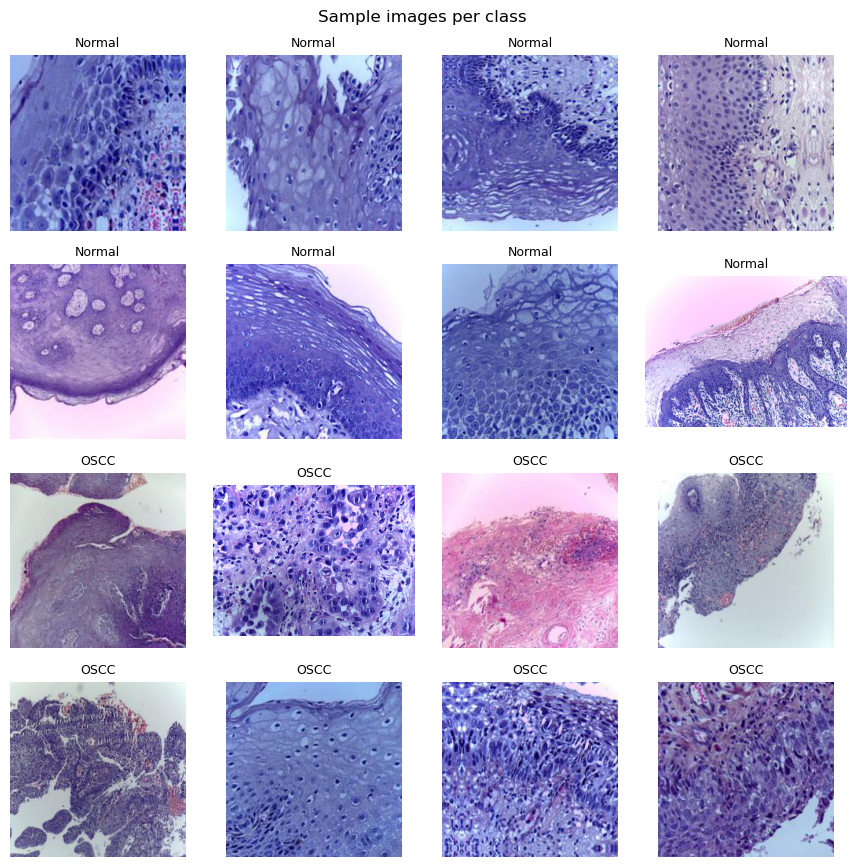

In [7]:
per_class = defaultdict(list)
for p, y in data:
    per_class[y].append(p)

samples = []
for cls, paths in per_class.items():
    k = min(len(paths), CONFIG_EDA["sample_per_class"])
    if k > 0:
        samples.extend([(p, cls) for p in random.sample(paths, k)])

# cap the grid size
if len(samples) > 64:
    samples = random.sample(samples, 64)

plot_image_grid(samples, title="Sample images per class")

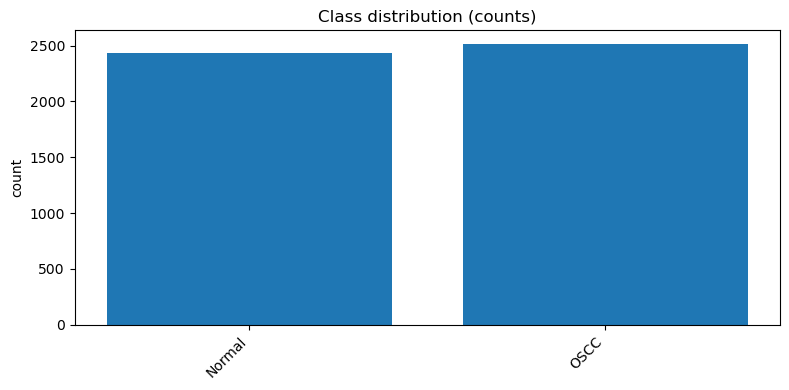

In [8]:
plot_class_distribution(df["label"].tolist(), title="Class distribution (counts)")

## Preprocessing 

### CONFIG_PRE & Settings Up

In [9]:
CONFIG_PRE = {
    # -------- Data source --------
    "label_format": "folder",           # "folder" | "csv"
    "image_root": f'{INPUT_DIR}/train',
    "csv_path": None,
    "label_col": None,
    "image_col": None, # "filepath",
    "id_col": None,
    "image_suffix": "", # ".jpg",
    "class_map": None,
    "valid_exts": [".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff"],
    "glob_pattern": "**/*",

    # -------- Sampling / limits --------
    "seed": 42,
    "per_class_visual_samples": 3,
    "max_images_per_class_eval": 80,
    "resize_short_side": 384,

    # -------- Cleaning toggles --------
    # List the methods you want to evaluate against RAW. Order = pipeline order (applied sequentially).
    # Allowed tokens: "clahe", "equalize", "defog", "denoise"
    # Example: ["defog", "denoise"] or ["clahe"] or [] (to test only RAW).
    "cleaners_for_test": ["clahe", "equalize", "defog", "denoise"],
    "photometric_for_test": ["color_jitter", "grayscale", "blur", "gaussian_noise", "sharpen", "bright_contrast"],

    # ---- Method params ----
    # CLAHE (exception)
    "clahe_clip_limit": 2.0,
    "clahe_tile_grid_size": 8,

    # Defog/Dehaze (Dark Channel Prior, lightweight)
    "defog_window": 15,       # odd
    "defog_omega": 0.95,      # haze amount (0..1)
    "defog_t0": 0.1,          # lower bound for transmission

    # Denoise
    "denoise_method": "auto", # "auto" | "nlmeans" | "median"
    "denoise_h": 7,           # NLM strength (OpenCV); typical 3..10
    "denoise_template": 7,    # NLM template window
    "denoise_search": 21,     # NLM search window
    "denoise_median_ksize": 3,# median kernel (odd)

    # Gaussian Noise
    "noise_mean": 0,
    "noise_sigma": 25,  # Tingkat noise (std dev)

    # Blur
    "blur_ksize": 5,    # Kernel size (ganjil)

    # Sharpen
    "sharpen_alpha": 1.5, # Strength (1.0 = normal sharpen, >1.0 stronger)
    
    # Brightness & Contrast (Specific)
    "bc_alpha": 1.2,    # Contrast control (1.0-3.0)
    "bc_beta": 30,      # Brightness control (0-100)

    # Color Jitter (Simulation)
    "jitter_brightness": 1.2,
    "jitter_contrast": 1.2,
    "jitter_saturation": 1.5,
    "jitter_hue": 0.1,

    # -------- Decision thresholds --------
    "min_rel_gain_contrast": 0.05,
    "min_rel_gain_edges": 0.05,
    "max_variability_cv": 0.50,

    # -------- Visualization --------
    "show_side_by_side": True,
}
print("Config Already Setting Up, Ready for Preprocesing ✅")

Config Already Setting Up, Ready for Preprocesing ✅


In [10]:
CONFIG_PRE.update({
    "fixed_cleaning_pipeline": ["equalize"],
    "photometric_on_top": ["sharpen"]
})
print("Config updated for Combo Preview.")

Config updated for Combo Preview.


### Declare & Utils

In [11]:
random.seed(CONFIG_PRE["seed"])
np.random.seed(CONFIG_PRE["seed"])

try:
    import cv2
    _HAS_CV2 = True
except Exception:
    cv2 = None
    _HAS_CV2 = False

def _is_image(p, exts):
    pl = p.lower()
    return any(pl.endswith(e) for e in exts)

def _collect_from_folder(root, valid_exts, glob_pattern="**/*"):
    paths = [p for p in glob.glob(os.path.join(root, glob_pattern), recursive=True) if _is_image(p, valid_exts)]
    data = []
    for p in paths:
        rel = os.path.relpath(p, root)
        parts = rel.split(os.sep)
        if len(parts) < 2:
            continue
        label = parts[0]
        data.append((p, label))
    return data

def _collect_from_csv(csv_path, image_root, label_col, image_col=None, id_col=None, image_suffix=".jpg"):
    df = pd.read_csv(csv_path)
    if image_col is None:
        if id_col is None:
            raise ValueError("Provide image_col or id_col in CONFIG_PRE for csv mode.")
        df["__image_path"] = df[id_col].astype(str) + image_suffix
    else:
        df["__image_path"] = df[image_col].astype(str)

    def join_path(p):
        if os.path.isabs(p):
            return p
        return os.path.join(image_root, p) if image_root else p

    paths = df["__image_path"].map(join_path).tolist()
    labels = df[label_col].tolist()
    return list(zip(paths, labels))

def pil_open_rgb(path, resize_short_side=None):
    with Image.open(path) as im:
        im = im.convert("RGB")
        s = CONFIG_PRE.get("resize_short_side")
        if resize_short_side is None:
            resize_short_side = s
        if resize_short_side:
            w, h = im.size
            if min(w, h) > resize_short_side:
                if w <= h:
                    new_w = resize_short_side
                    new_h = int(h * (resize_short_side / w))
                else:
                    new_h = resize_short_side
                    new_w = int(w * (resize_short_side / h))
                im = im.resize((new_w, new_h), Image.LANCZOS)
        return np.array(im)

def load_dataset():
    fmt = CONFIG_PRE["label_format"].lower()
    if fmt == "folder":
        data = _collect_from_folder(CONFIG_PRE["image_root"], CONFIG_PRE["valid_exts"], CONFIG_PRE["glob_pattern"])
    elif fmt == "csv":
        data = _collect_from_csv(
            CONFIG_PRE["csv_path"], CONFIG_PRE["image_root"], CONFIG_PRE["label_col"],
            image_col=CONFIG_PRE.get("image_col"),
            id_col=CONFIG_PRE.get("id_col"),
            image_suffix=CONFIG_PRE.get("image_suffix", ".jpg"),
        )
    else:
        raise ValueError("Unsupported label_format. Use 'folder' or 'csv'.")

    cmap = CONFIG_PRE.get("class_map")
    out = []
    for p, y in data:
        if os.path.isfile(p):
            out.append((p, cmap.get(y, y) if cmap else y))
    return out

def to_gray(arr):
    return np.dot(arr[..., :3], [0.2989, 0.5870, 0.1140]).astype(np.float32)

def _clahe_rgb(arr, clip_limit=2.0, tile_grid_size=8):
    if not _HAS_CV2:
        out = np.empty_like(arr)
        for c in range(3):
            ch = Image.fromarray(arr[..., c], mode="L")
            ch = ImageOps.equalize(ch)
            out[..., c] = np.array(ch)
        return out, "he_fallback_no_cv2"
    import numpy as _np
    lab = cv2.cvtColor(arr, cv2.COLOR_RGB2LAB)
    L, A, B = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=float(clip_limit), tileGridSize=(int(tile_grid_size), int(tile_grid_size)))
    L2 = clahe.apply(L)
    lab2 = cv2.merge([L2, A, B])
    out = cv2.cvtColor(lab2, cv2.COLOR_LAB2RGB)
    return out, "clahe_lab"

def _equalize_rgb(arr):
    out = np.empty_like(arr)
    for c in range(3):
        ch = Image.fromarray(arr[..., c], mode="L")
        ch = ImageOps.equalize(ch)
        out[..., c] = np.array(ch)
    return out, "equalize"

def _defog_dcp(arr, win=15, omega=0.95, t0=0.1):
    if not _HAS_CV2:
        return _equalize_rgb(arr)
    I = arr.astype(np.float32) / 255.0
    min_per_pix = np.min(I, axis=2)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (win, win))
    dark = cv2.erode(min_per_pix, kernel)
    n_pixels = dark.size
    n_search = max(1, n_pixels // 1000)
    idx = np.argpartition(dark.ravel(), -n_search)[-n_search:]
    A = I.reshape(-1, 3)[idx].mean(axis=0)
    norm = I / (A.reshape(1,1,3) + 1e-6)
    t = 1.0 - omega * cv2.erode(np.min(norm, axis=2), kernel)
    t = np.clip(t, t0, 1.0)
    J = (I - A.reshape(1,1,3)) / t[..., None] + A.reshape(1,1,3)
    J = np.clip(J, 0, 1)
    out = (J * 255.0).astype(np.uint8)
    return out, "defog_dcp"

def _denoise(arr):
    method = CONFIG_PRE.get("denoise_method", "auto")
    if method == "auto":
        method = "nlmeans" if _HAS_CV2 else "median"
    if method == "nlmeans" and _HAS_CV2:
        h = int(CONFIG_PRE.get("denoise_h", 7))
        tmpl = int(CONFIG_PRE.get("denoise_template", 7))
        srch = int(CONFIG_PRE.get("denoise_search", 21))
        out = cv2.fastNlMeansDenoisingColored(arr, None, h, h, tmpl, srch)
        return out, "denoise_nlmeans"
    else:
        k = int(CONFIG_PRE.get("denoise_median_ksize", 3))
        if k % 2 == 0: k += 1
        if _HAS_CV2:
            out = cv2.medianBlur(arr, k)
        else:
            g = Image.fromarray(arr).convert("L").filter(ImageFilter.MedianFilter(size=k))
            g = np.array(g)
            out = np.stack([g, g, g], axis=-1)
        return out, "denoise_median"

def apply_cleaners_pipeline(arr, cleaners):
    out = arr
    tags = []
    for step in cleaners:
        s = step.lower()
        if s == "clahe":
            out, tag = _clahe_rgb(out, CONFIG_PRE["clahe_clip_limit"], CONFIG_PRE["clahe_tile_grid_size"])
        elif s == "equalize":
            out, tag = _equalize_rgb(out)
        elif s == "defog":
            out, tag = _defog_dcp(out, CONFIG_PRE["defog_window"], CONFIG_PRE["defog_omega"], CONFIG_PRE["defog_t0"])
        elif s == "denoise":
            out, tag = _denoise(out)
        else:
            raise ValueError(f"Unknown cleaner: {s}")
        tags.append(tag)
    return out, "+".join(tags) if tags else "none"

def rms_contrast(gray):
    g = gray.astype(np.float32)
    return float(g.std())

def shannon_entropy(gray):
    hist, _ = np.histogram(gray.ravel(), bins=256, range=(0,256), density=True)
    hist = hist[hist > 0]
    return float(-(hist * np.log2(hist)).sum())

def edge_density(gray):
    Kx = np.array([[1,0,-1],[2,0,-2],[1,0,-1]], dtype=np.float32)
    Ky = np.array([[1,2,1],[0,0,0],[-1,-2,-1]], dtype=np.float32)
    try:
        from scipy.signal import convolve2d
        gx = convolve2d(gray, Kx, mode="same", boundary="symm")
        gy = convolve2d(gray, Ky, mode="same", boundary="symm")
    except Exception:
        gx = np.zeros_like(gray, dtype=np.float32)
        gy = np.zeros_like(gray, dtype=np.float32)
        gx[:,1:-1] = (gray[:,2:] - gray[:,:-2]) * 0.5
        gy[1:-1,:] = (gray[2:,:] - gray[:-2,:]) * 0.5
    mag = np.hypot(gx, gy)
    thr = np.percentile(mag, 75)
    edges = (mag >= thr)
    return float(edges.mean())

def eval_metrics_on_image(arr):
    g = to_gray(arr)
    return {
        "contrast_rms": rms_contrast(g),
        "entropy": shannon_entropy(g),
        "edge_density": edge_density(g),
    }

def _add_gaussian_noise(arr, mean=0, sigma=25):
    """Menambahkan Gaussian Noise pada gambar RGB."""
    row, col, ch = arr.shape
    gauss = np.random.normal(mean, sigma, (row, col, ch))
    noisy = arr.astype(np.float32) + gauss
    noisy = np.clip(noisy, 0, 255).astype(np.uint8)
    return noisy, "gaussian_noise"

def _apply_blur(arr, ksize=5):
    """Apply Average Blur atau Gaussian Blur."""
    if ksize % 2 == 0: ksize += 1
    if _HAS_CV2:
        out = cv2.GaussianBlur(arr, (ksize, ksize), 0)
    else:
        out = np.array(Image.fromarray(arr).filter(ImageFilter.GaussianBlur(radius=ksize//2)))
    return out, "blur"

def _apply_sharpen(arr, strength=1.0):
    """Apply sharpening filter."""
    if _HAS_CV2:
        # Standard sharpening kernel
        kernel = np.array([[0, -1, 0], 
                           [-1, 5, -1], 
                           [0, -1, 0]])
        # Jika ingin kontrol strength manual, bisa dilakukan weighting dengan original image
        out = cv2.filter2D(arr, -1, kernel)
    else:
        out = np.array(Image.fromarray(arr).filter(ImageFilter.SHARPEN))
    return out, "sharpen"

def _adjust_bright_contrast(arr, alpha=1.2, beta=30):
    """Alpha=Contrast, Beta=Brightness"""
    if _HAS_CV2:
        out = cv2.convertScaleAbs(arr, alpha=alpha, beta=beta)
    else:
        # Fallback PIL
        img = Image.fromarray(arr)
        img = ImageEnhance.Brightness(img).enhance(1 + (beta/255.0)) # approx
        img = ImageEnhance.Contrast(img).enhance(alpha)
        out = np.array(img)
    return out, "bright_contrast"

def _simulate_color_jitter(arr, b=1.0, c=1.0, s=1.0, h=0.0):
    """Simulasi Color Jitter menggunakan PIL (lebih stabil untuk operasi HSL/HSV)."""
    img = Image.fromarray(arr)
    # Urutan acak jitter simulasi
    transforms = [
        lambda i: ImageEnhance.Brightness(i).enhance(b),
        lambda i: ImageEnhance.Contrast(i).enhance(c),
        lambda i: ImageEnhance.Color(i).enhance(s)
    ]
    # Apply brightness, contrast, saturation
    for t in transforms:
        img = t(img)
    
    # Apply Hue (Convert to HSV -> Shift H -> Convert Back) - Optional complex logic
    # Disini kita skip hue rotation manual yg kompleks agar tetap ringan, 
    # fokus ke Brightness/Contrast/Saturation
    out = np.array(img)
    return out, "color_jitter"

def _to_grayscale_3ch(arr):
    """Grayscale tapi tetap shape (H, W, 3) untuk visualisasi konsisten."""
    if _HAS_CV2:
        gray = cv2.cvtColor(arr, cv2.COLOR_RGB2GRAY)
        out = cv2.cvtColor(gray, cv2.COLOR_GRAY2RGB)
    else:
        g = Image.fromarray(arr).convert("L")
        out = np.array(g.convert("RGB"))
    return out, "grayscale"

def apply_photometric_single(arr, method):
    """Dispatcher function untuk photometric preview."""
    m = method.lower()
    if m == "grayscale":
        return _to_grayscale_3ch(arr)
    elif m == "blur":
        return _apply_blur(arr, CONFIG_PRE["blur_ksize"])
    elif m == "gaussian_noise":
        return _add_gaussian_noise(arr, CONFIG_PRE["noise_mean"], CONFIG_PRE["noise_sigma"])
    elif m == "sharpen":
        return _apply_sharpen(arr, CONFIG_PRE["sharpen_alpha"])
    elif m == "bright_contrast":
        return _adjust_bright_contrast(arr, CONFIG_PRE["bc_alpha"], CONFIG_PRE["bc_beta"])
    elif m == "color_jitter":
        return _simulate_color_jitter(arr, 
                                      CONFIG_PRE["jitter_brightness"],
                                      CONFIG_PRE["jitter_contrast"],
                                      CONFIG_PRE["jitter_saturation"],
                                      CONFIG_PRE["jitter_hue"])
    else:
        return arr, f"unknown_{m}"

Total images: 4946
Num classes: 2
label
OSCC      2511
Normal    2435
Name: path, dtype: int64


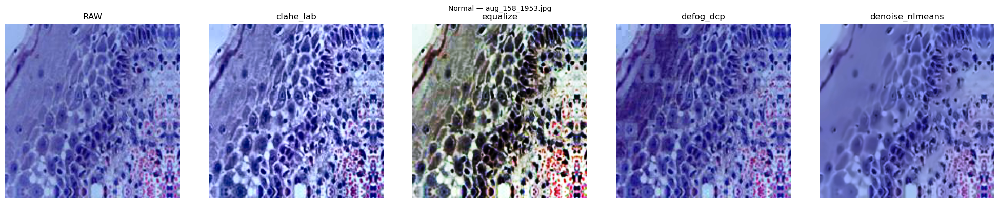

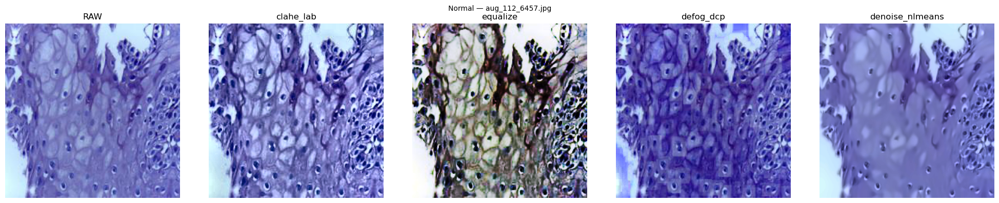

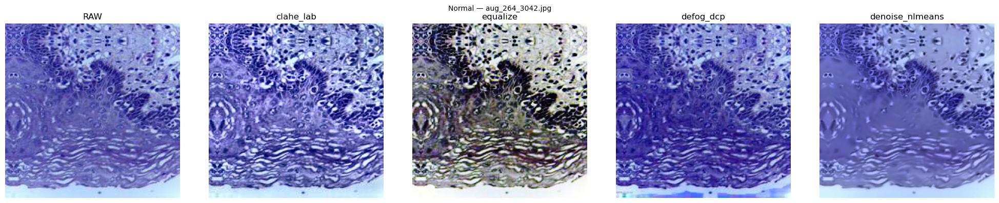

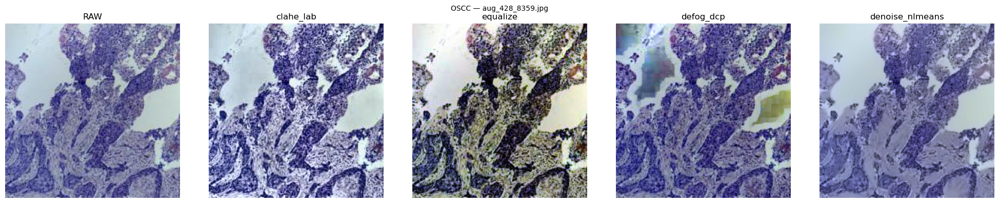

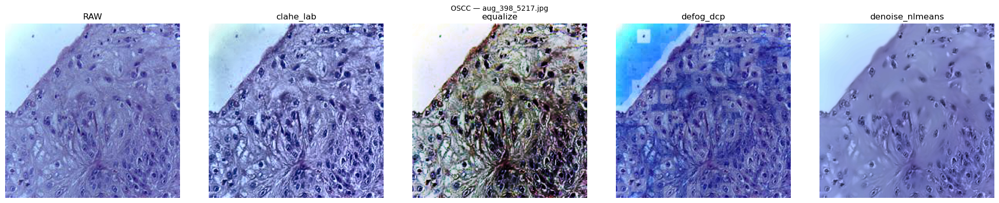

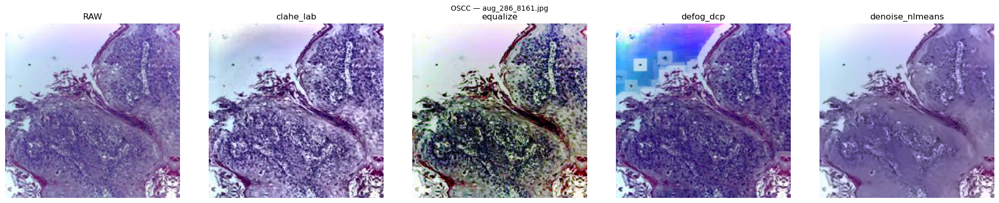

In [12]:
data = load_dataset()
if not data:
    raise SystemExit("No images found. Check CONFIG paths/columns.")

df = pd.DataFrame(data, columns=["path", "label"])
print("Total images:", len(df))
print("Num classes:", df["label"].nunique())
print(df.groupby("label")["path"].count().sort_values(ascending=False).head())

if CONFIG_PRE["show_side_by_side"]:
    per_class = defaultdict(list)
    for p, y in data:
        per_class[y].append(p)

    demo_cleaners = CONFIG_PRE["cleaners_for_test"]
    n_show = CONFIG_PRE["per_class_visual_samples"]

    for cls, paths in per_class.items():
        samp = random.sample(paths, min(len(paths), n_show))
        for p in samp:
            raw = pil_open_rgb(p, CONFIG_PRE["resize_short_side"])

            cols = 1 + max(1, len(demo_cleaners))
            fig, axes = plt.subplots(1, cols, figsize=(4*cols, 4))
            axes = np.atleast_1d(axes)

            axes[0].imshow(raw); axes[0].set_title("RAW"); axes[0].axis("off")

            for j, pipeline in enumerate(demo_cleaners, start=1):
                cleaned, tag = apply_cleaners_pipeline(raw, [pipeline] if isinstance(pipeline, str) else list(pipeline))
                axes[j].imshow(cleaned); axes[j].set_title(tag); axes[j].axis("off")

            plt.suptitle(f"{cls} — {os.path.basename(p)}", fontsize=10)
            plt.tight_layout()
            plt.show()

Generating Photometric Previews...


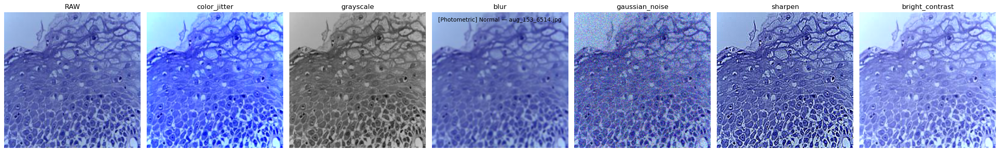

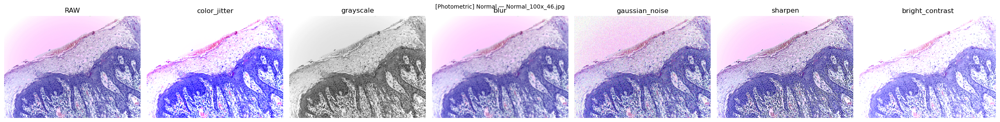

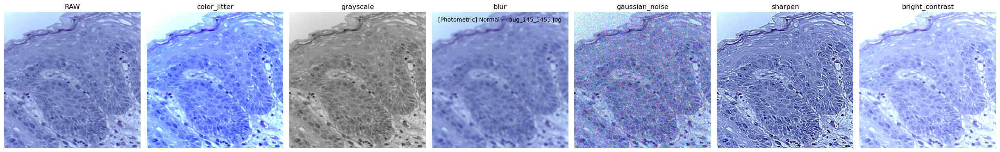

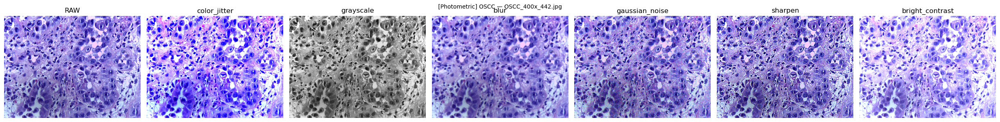

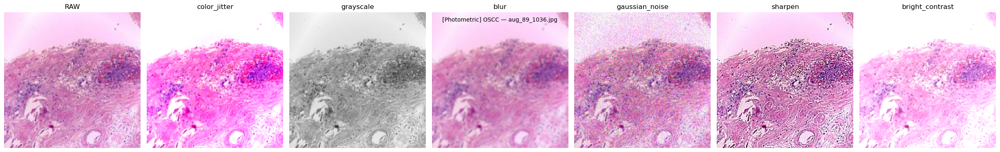

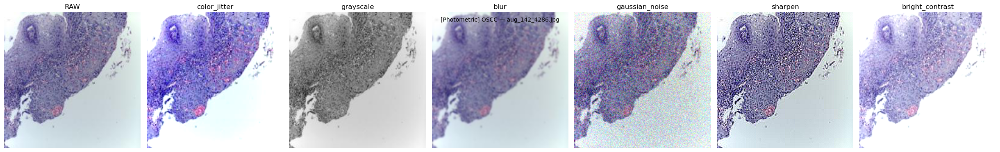

In [13]:
if CONFIG_PRE["show_side_by_side"]:
    print("Generating Photometric Previews...")
    
    per_class = defaultdict(list)
    for p, y in data:
        per_class[y].append(p)

    photo_methods = CONFIG_PRE["photometric_for_test"]
    n_show = CONFIG_PRE["per_class_visual_samples"]

    for cls, paths in per_class.items():
        # Ambil sampel acak
        samp = random.sample(paths, min(len(paths), n_show))
        
        for p in samp:
            raw = pil_open_rgb(p, CONFIG_PRE["resize_short_side"])

            # Hitung kolom: 1 (RAW) + Jumlah Method Photometric
            cols = 1 + len(photo_methods)
            fig, axes = plt.subplots(1, cols, figsize=(3.5*cols, 4))
            axes = np.atleast_1d(axes)

            # 1. Plot RAW
            axes[0].imshow(raw)
            axes[0].set_title("RAW")
            axes[0].axis("off")

            # 2. Plot Photometric Effects
            for j, method in enumerate(photo_methods, start=1):
                processed, tag = apply_photometric_single(raw, method)
                axes[j].imshow(processed)
                axes[j].set_title(tag)
                axes[j].axis("off")

            plt.suptitle(f"[Photometric] {cls} — {os.path.basename(p)}", fontsize=10, y=0.85)
            plt.tight_layout()
            plt.show()

🔗 Generating Combo Previews (Raw -> Cleaned -> Cleaned+Photo)...


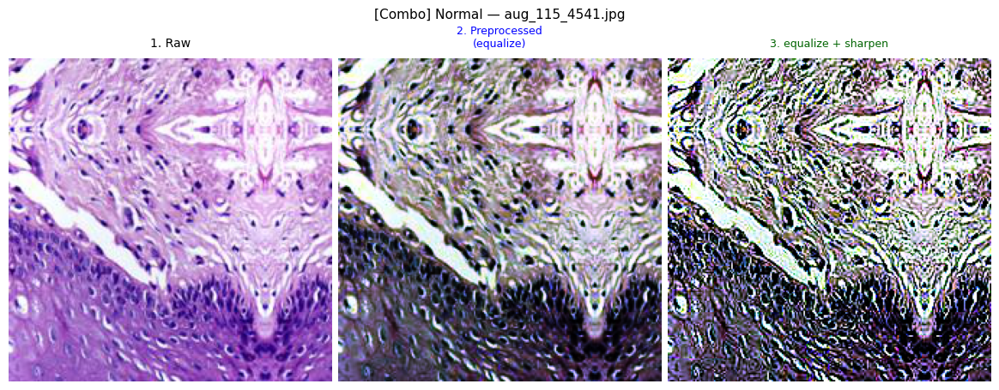

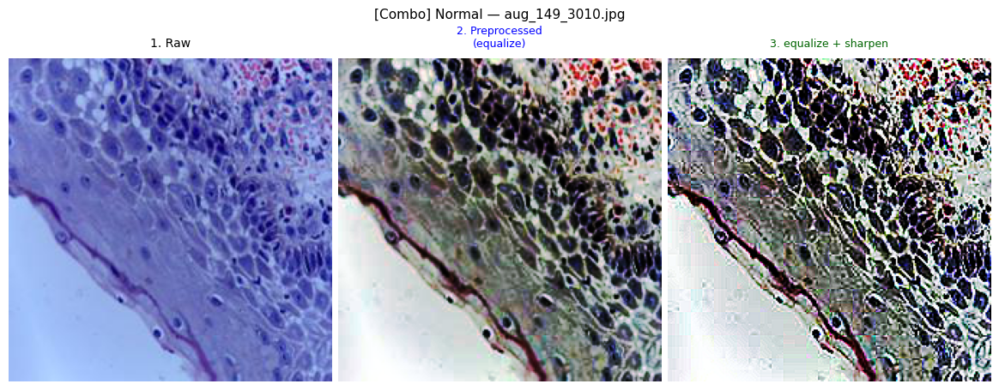

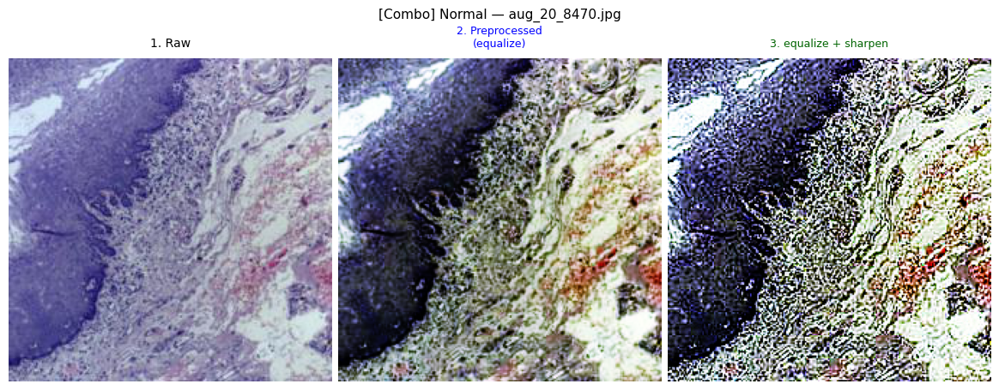

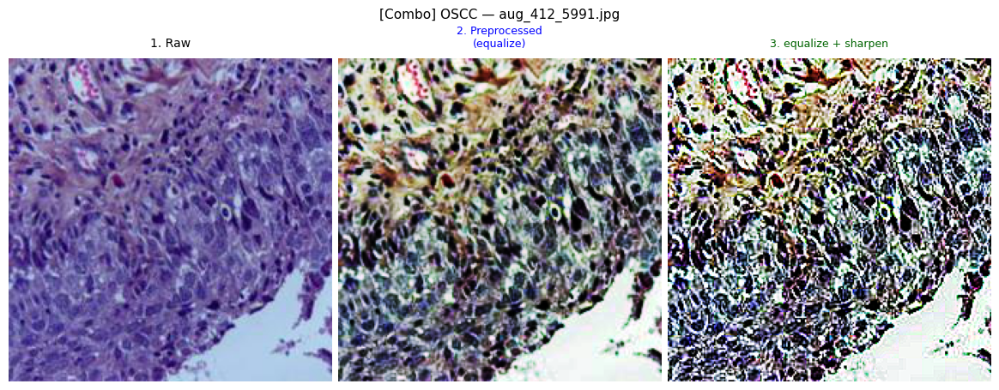

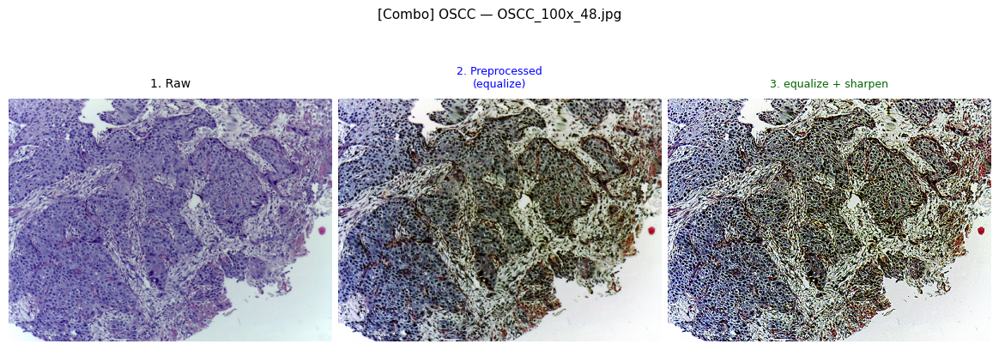

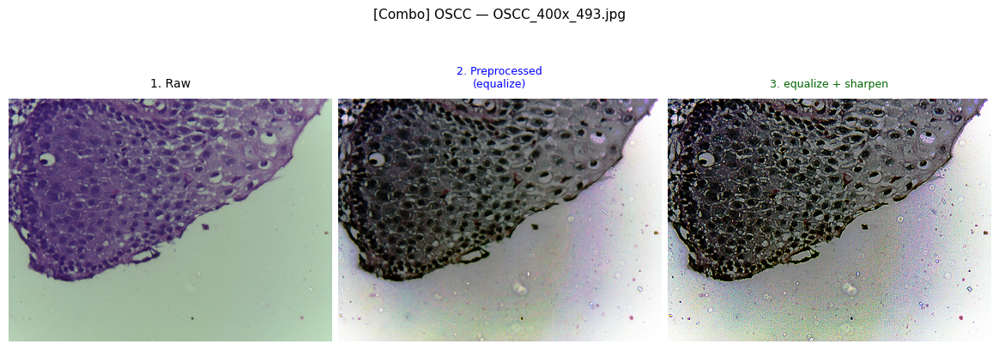

In [14]:
if CONFIG_PRE["show_side_by_side"]:
    print("🔗 Generating Combo Previews (Raw -> Cleaned -> Cleaned+Photo)...")
    
    # Ambil sample data
    per_class = defaultdict(list)
    for p, y in data:
        per_class[y].append(p)

    cleaners_seq = CONFIG_PRE["fixed_cleaning_pipeline"]
    photo_methods = CONFIG_PRE["photometric_on_top"]
    n_show = CONFIG_PRE["per_class_visual_samples"]

    for cls, paths in per_class.items():
        samp = random.sample(paths, min(len(paths), n_show))
        
        for p in samp:
            raw = pil_open_rgb(p, CONFIG_PRE["resize_short_side"])

            # Hitung jumlah kolom: 
            # 1 (RAW) + 1 (Full Cleaned Result) + N (Photometric variations)
            cols = 2 + len(photo_methods)
            fig, axes = plt.subplots(1, cols, figsize=(4*cols, 5)) # Perlebar figsize sedikit
            axes = np.atleast_1d(axes)

            # --- STEP 1: RAW ---
            axes[0].imshow(raw)
            axes[0].set_title("1. Raw", fontsize=10, pad=10)
            axes[0].axis("off")

            # --- STEP 2: APPLY FULL CLEANING PIPELINE ---
            # Fungsi apply_cleaners_pipeline sudah otomatis chain list cleaners
            cleaned_img, clean_tag = apply_cleaners_pipeline(raw, cleaners_seq)
            
            axes[1].imshow(cleaned_img)
            # Judul lebih jelas, nama pipeline di baris baru
            axes[1].set_title(f"2. Preprocessed\n({clean_tag})", fontsize=9, color='blue', pad=10)
            axes[1].axis("off")

            # --- STEP 3: APPLY PHOTOMETRIC ON TOP OF CLEANED ---
            for j, photo_method in enumerate(photo_methods, start=2):
                # Inputnya adalah 'cleaned_img', BUKAN 'raw'
                final_img, photo_tag = apply_photometric_single(cleaned_img, photo_method)
                
                axes[j].imshow(final_img)
                # PERBAIKAN UTAMA: Judul eksplisit (Preprocessed + Photometric)
                axes[j].set_title(f"3. {clean_tag} + {photo_tag}", fontsize=9, color='darkgreen', pad=10)
                axes[j].axis("off")

            # Judul Utama per Baris (diatur posisinya agar tidak menimpa)
            plt.suptitle(f"[Combo] {cls} — {os.path.basename(p)}", fontsize=11, y=0.95)
            # Gunakan tight_layout dengan padding yang cukup
            plt.tight_layout(pad=2.0, w_pad=0.5, h_pad=1.0)
            plt.show()

Per-image metrics (head):


,class,path,method,contrast,entropy,edges,gain_contrast,gain_entropy,gain_edges
0,Normal,data/histopathologic-oral-cancer/train\Normal\...,RAW,36.961166,7.035103,0.25,0.000000,0.000000,0.0
1,Normal,data/histopathologic-oral-cancer/train\Normal\...,clahe_lab,51.291744,7.625496,0.25,0.387720,0.083921,0.0
2,Normal,data/histopathologic-oral-cancer/train\Normal\...,equalize,74.077492,7.961711,0.25,1.004198,0.131712,0.0
3,Normal,data/histopathologic-oral-cancer/train\Normal\...,defog_dcp,45.796402,7.461217,0.25,0.239041,0.060570,0.0
4,Normal,data/histopathologic-oral-cancer/train\Normal\...,denoise_nlmeans,34.856865,6.682671,0.25,-0.056933,-0.050096,0.0



Per-class median metrics by method:


,class,method,contrast,entropy,edges,gain_contrast,gain_entropy,gain_edges
0,Normal,RAW,47.282896,7.233161,0.25,0.000000,0.000000,0.0
1,Normal,clahe_lab,56.515234,7.697416,0.25,0.267254,0.059856,0.0
2,Normal,defog_dcp,48.509335,7.466091,0.25,0.092148,0.026538,0.0
3,Normal,denoise_nlmeans,45.644247,6.991675,0.25,-0.034733,-0.030860,0.0
4,Normal,equalize,73.453163,7.947252,0.25,0.583495,0.100267,0.0
5,OSCC,RAW,44.614441,7.157092,0.25,0.000000,0.000000,0.0
6,OSCC,clahe_lab,58.641655,7.725806,0.25,0.305583,0.069150,0.0
7,OSCC,defog_dcp,44.777910,7.333262,0.25,-0.017084,0.014763,0.0
8,OSCC,denoise_nlmeans,43.022642,6.959892,0.25,-0.033276,-0.028510,0.0
9,OSCC,equalize,73.351265,7.946286,0.25,0.658174,0.110926,0.0



Global median gains by method (vs dataset_raw):


,method,gain_contrast,gain_entropy,gain_edges
3,equalize,0.626548,0.102130,0.0
0,clahe_lab,0.282083,0.063782,0.0
1,defog_dcp,0.051032,0.022629,0.0
2,denoise_nlmeans,-0.033925,-0.029495,0.0


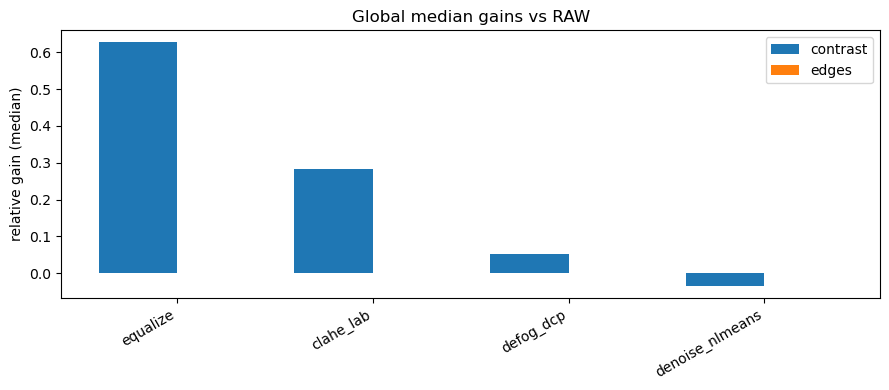

In [15]:
per_class = defaultdict(list)
for p, y in data:
    per_class[y].append(p)

records = []
max_eval = int(CONFIG_PRE["max_images_per_class_eval"])

for cls, paths in per_class.items():
    sel = random.sample(paths, min(len(paths), max_eval))
    for p in sel:
        raw = pil_open_rgb(p, CONFIG_PRE["resize_short_side"])
        m_raw = eval_metrics_on_image(raw)

        records.append({
            "class": cls, "path": p, "method": "RAW",
            "contrast": m_raw["contrast_rms"],
            "entropy":  m_raw["entropy"],
            "edges":    m_raw["edge_density"],
            "gain_contrast": 0.0,
            "gain_entropy":  0.0,
            "gain_edges":    0.0,
        })

        for token in CONFIG_PRE["cleaners_for_test"]:
            pipeline = [token] if isinstance(token, str) else list(token)
            cleaned, tag = apply_cleaners_pipeline(raw, pipeline)
            m_cln = eval_metrics_on_image(cleaned)

            eps = 1e-9
            g_c = (m_cln["contrast_rms"] - m_raw["contrast_rms"]) / max(eps, m_raw["contrast_rms"])
            g_e = (m_cln["edge_density"] - m_raw["edge_density"])   / max(eps, m_raw["edge_density"])
            g_h = (m_cln["entropy"] - m_raw["entropy"])             / max(eps, m_raw["entropy"])

            records.append({
                "class": cls, "path": p, "method": tag,
                "contrast": m_cln["contrast_rms"],
                "entropy":  m_cln["entropy"],
                "edges":    m_cln["edge_density"],
                "gain_contrast": g_c,
                "gain_entropy":  g_h,
                "gain_edges":    g_e,
            })

metrics_df = pd.DataFrame(records)

print("Per-image metrics (head):")
display(metrics_df.head())

summary = (metrics_df
           .groupby(["class","method"], as_index=False)[
               ["contrast","entropy","edges","gain_contrast","gain_entropy","gain_edges"]
           ]
           .median()
          )

print("\nPer-class median metrics by method:")
display(summary)

global_summary = (metrics_df[metrics_df["method"]!="RAW"]
                  .groupby("method", as_index=False)[["gain_contrast","gain_entropy","gain_edges"]]
                  .median()
                 ).sort_values("gain_contrast", ascending=False)

print("\nGlobal median gains by method (vs dataset_raw):")
display(global_summary)

plt.figure(figsize=(9,4))
x = np.arange(len(global_summary))
plt.bar(x-0.2, global_summary["gain_contrast"].values, width=0.4, label="contrast")
plt.bar(x+0.2, global_summary["gain_edges"].values,    width=0.4, label="edges")
plt.xticks(x, global_summary["method"].tolist(), rotation=30, ha="right")
plt.ylabel("relative gain (median)")
plt.title("Global median gains vs RAW")
plt.legend(); plt.tight_layout(); plt.show()

Starting Photometric Quantitative Evaluation...
Per-image photometric metrics (head):


,class,path,method,contrast,entropy,edges,gain_contrast,gain_entropy,gain_edges
0,Normal,data/histopathologic-oral-cancer/train\Normal\...,RAW,55.897194,6.913481,0.25,0.000000,0.000000,0.0
1,Normal,data/histopathologic-oral-cancer/train\Normal\...,color_jitter,72.560455,5.460596,0.25,0.298106,-0.210153,0.0
2,Normal,data/histopathologic-oral-cancer/train\Normal\...,grayscale,55.885735,6.910617,0.25,-0.000205,-0.000414,0.0
3,Normal,data/histopathologic-oral-cancer/train\Normal\...,blur,55.041096,6.891677,0.25,-0.015316,-0.003154,0.0
4,Normal,data/histopathologic-oral-cancer/train\Normal\...,gaussian_noise,57.719318,7.441424,0.25,0.032598,0.076364,0.0



Per-class median metrics by photometric method:


,class,method,contrast,entropy,edges,gain_contrast,gain_entropy,gain_edges
0,Normal,RAW,43.706810,7.230330,0.25000,0.000000,0.000000,0.00000
1,Normal,blur,39.600254,7.030321,0.25000,-0.085666,-0.025515,0.00000
2,Normal,bright_contrast,44.382992,6.613227,0.25000,0.013288,-0.087015,0.00000
3,Normal,color_jitter,55.626198,7.066087,0.25000,0.282837,-0.001105,0.00000
4,Normal,gaussian_noise,46.270653,7.446955,0.25000,0.058660,0.032229,0.00000
5,Normal,grayscale,43.708101,7.228729,0.25002,-0.000029,0.000013,0.00008
6,Normal,sharpen,63.149357,7.593970,0.25000,0.377630,0.058075,0.00000
7,OSCC,RAW,44.491695,7.172231,0.25000,0.000000,0.000000,0.00000
8,OSCC,blur,40.301361,6.939815,0.25000,-0.096608,-0.029372,0.00000
9,OSCC,bright_contrast,47.204208,6.844646,0.25000,0.048173,-0.046993,0.00000



Global median gains by photometric method (vs RAW):


,method,gain_contrast,gain_entropy,gain_edges
5,sharpen,3.902516e-01,0.058233,0.00000
2,color_jitter,2.920893e-01,0.009451,0.00000
3,gaussian_noise,5.181375e-02,0.031951,0.00000
1,bright_contrast,2.426327e-02,-0.056292,0.00000
4,grayscale,-1.607862e-08,0.000019,0.00008
0,blur,-9.177721e-02,-0.027527,0.00000


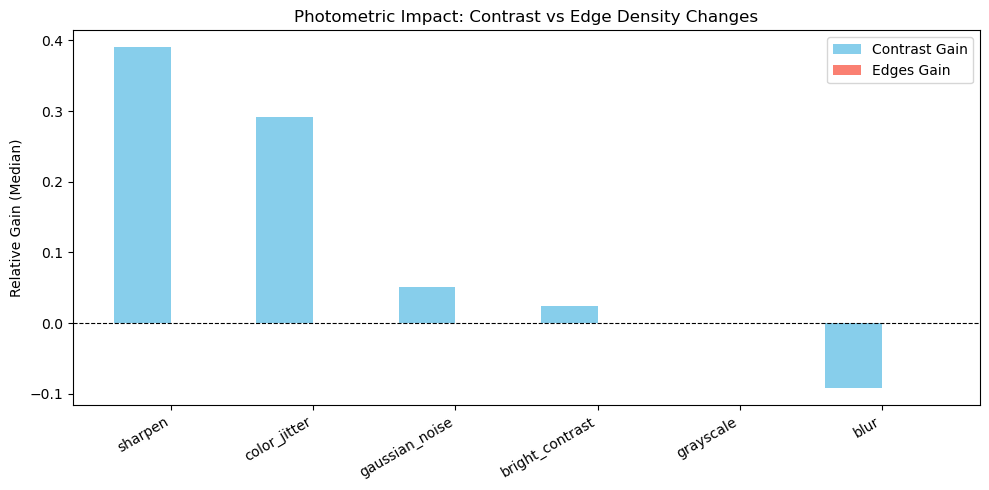

In [16]:
print("Starting Photometric Quantitative Evaluation...")

# 1. Collect Data paths per class
per_class = defaultdict(list)
for p, y in data:
    per_class[y].append(p)

records_photo = []
max_eval = int(CONFIG_PRE["max_images_per_class_eval"])

# 2. Iterate Classes & Images
for cls, paths in per_class.items():
    # Sampling image agar tidak terlalu berat
    sel = random.sample(paths, min(len(paths), max_eval))
    
    for p in sel:
        # Load RAW Image
        raw = pil_open_rgb(p, CONFIG_PRE["resize_short_side"])
        m_raw = eval_metrics_on_image(raw)

        # Record Baseline (RAW)
        records_photo.append({
            "class": cls, "path": p, "method": "RAW",
            "contrast": m_raw["contrast_rms"],
            "entropy":  m_raw["entropy"],
            "edges":    m_raw["edge_density"],
            "gain_contrast": 0.0,
            "gain_entropy":  0.0,
            "gain_edges":    0.0,
        })

        # Apply Photometric Methods Loop
        for method in CONFIG_PRE["photometric_for_test"]:
            # Apply transformation
            processed, tag = apply_photometric_single(raw, method)
            
            # Calculate metrics on processed image
            m_new = eval_metrics_on_image(processed)

            # Calculate Gains (Relative change vs RAW)
            eps = 1e-9
            g_c = (m_new["contrast_rms"] - m_raw["contrast_rms"]) / max(eps, m_raw["contrast_rms"])
            g_e = (m_new["edge_density"] - m_raw["edge_density"]) / max(eps, m_raw["edge_density"])
            g_h = (m_new["entropy"] - m_raw["entropy"])          / max(eps, m_raw["entropy"])

            records_photo.append({
                "class": cls, "path": p, "method": tag,
                "contrast": m_new["contrast_rms"],
                "entropy":  m_new["entropy"],
                "edges":    m_new["edge_density"],
                "gain_contrast": g_c,
                "gain_entropy":  g_h,
                "gain_edges":    g_e,
            })

# 3. Create DataFrame
metrics_photo_df = pd.DataFrame(records_photo)

print("Per-image photometric metrics (head):")
display(metrics_photo_df.head())

# 4. Summarize per Class
summary_photo = (metrics_photo_df
            .groupby(["class","method"], as_index=False)[
                ["contrast","entropy","edges","gain_contrast","gain_entropy","gain_edges"]
            ]
            .median()
          )

print("\nPer-class median metrics by photometric method:")
display(summary_photo)

# 5. Global Summary (Aggregated across all classes)
global_summary_photo = (metrics_photo_df[metrics_photo_df["method"]!="RAW"]
                  .groupby("method", as_index=False)[["gain_contrast","gain_entropy","gain_edges"]]
                  .median()
                 ).sort_values("gain_contrast", ascending=False)

print("\nGlobal median gains by photometric method (vs RAW):")
display(global_summary_photo)

# 6. Visualization
plt.figure(figsize=(10, 5))
x = np.arange(len(global_summary_photo))

# Plotting Contrast & Edges Gain
# Note: Untuk photometric, nilai negatif sangat wajar (misal: Blur menurunkan Edges)
plt.bar(x - 0.2, global_summary_photo["gain_contrast"].values, width=0.4, label="Contrast Gain", color='skyblue')
plt.bar(x + 0.2, global_summary_photo["gain_edges"].values,    width=0.4, label="Edges Gain", color='salmon')

plt.axhline(0, color='black', linewidth=0.8, linestyle='--') # Garis nol untuk referensi
plt.xticks(x, global_summary_photo["method"].tolist(), rotation=30, ha="right")
plt.ylabel("Relative Gain (Median)")
plt.title("Photometric Impact: Contrast vs Edge Density Changes")
plt.legend()
plt.tight_layout()
plt.show()

In [17]:
thr_contrast = float(CONFIG_PRE["min_rel_gain_contrast"])
thr_edges    = float(CONFIG_PRE["min_rel_gain_edges"])
max_cv       = float(CONFIG_PRE["max_variability_cv"])

def coef_var(x):
    x = np.asarray(x, dtype=float)
    mu = np.mean(np.abs(x)) + 1e-9
    sd = np.std(x)
    return float(sd / mu)

print("=== Candidate methods evaluated ===")
print(sorted(metrics_df["method"].unique().tolist()))

recommendations = []

for method in sorted(m for m in metrics_df["method"].unique() if m != "RAW"):
    m = metrics_df[metrics_df["method"] == method]
    g_contrast_med = float(m["gain_contrast"].median())
    g_edges_med    = float(m["gain_edges"].median())
    g_entropy_med  = float(m["gain_entropy"].median())

    cv_contrast = coef_var(m["gain_contrast"].values)
    cv_edges    = coef_var(m["gain_edges"].values)

    meaningful = (g_contrast_med >= thr_contrast) and (g_edges_med >= thr_edges)
    consistent = (cv_contrast <= max_cv) and (cv_edges <= max_cv)

    verdict = ("PREPROCESS", "Use as a standard step") if (meaningful and consistent) else \
              ("AUGMENT",    "Prefer augmentation / optional or conditional use")

    recommendations.append({
        "method": method,
        "median_gain_contrast": g_contrast_med,
        "median_gain_edges": g_edges_med,
        "median_gain_entropy": g_entropy_med,
        "cv_contrast": cv_contrast,
        "cv_edges": cv_edges,
        "meaningful": meaningful,
        "consistent": consistent,
        "decision": verdict[0],
        "note": verdict[1],
    })

rec_df = pd.DataFrame(recommendations).sort_values(
    ["decision","median_gain_contrast","median_gain_edges"],
    ascending=[True, False, False]
)

from IPython.display import display
print("\n=== Method-wise recommendation (vs RAW) ===")
display(rec_df)

print("\n=== Guidance ===")
for r in recommendations:
    m = r["method"]
    dec = r["decision"]
    print(f"- {m}: {dec} | med Δcontrast={r['median_gain_contrast']:+.3f}, "
          f"med Δedges={r['median_gain_edges']:+.3f}, CV(contrast)={r['cv_contrast']:.2f}, "
          f"CV(edges)={r['cv_edges']:.2f} — {r['note']}")

print("\nLitmus test:")
print('“Is this flaw present in 90–100% of my images due to equipment/environment?”')
print("* YES → It's consistent/technical → adopt PREPROCESSING (e.g., CLAHE, denoise, defog).")
print("* NO  → It's random/varied → don't ‘fix’ it; prefer AUGMENTATION to build robustness.")

=== Candidate methods evaluated ===
['RAW', 'clahe_lab', 'defog_dcp', 'denoise_nlmeans', 'equalize']

=== Method-wise recommendation (vs RAW) ===


,method,median_gain_contrast,median_gain_edges,median_gain_entropy,cv_contrast,cv_edges,meaningful,consistent,decision,note
3,equalize,0.626548,0.0,0.102130,0.613869,5.925666,False,False,AUGMENT,Prefer augmentation / optional or conditional use
0,clahe_lab,0.282083,0.0,0.063782,0.644071,6.241866,False,False,AUGMENT,Prefer augmentation / optional or conditional use
1,defog_dcp,0.051032,0.0,0.022629,1.193379,6.241866,False,False,AUGMENT,Prefer augmentation / optional or conditional use
2,denoise_nlmeans,-0.033925,0.0,-0.029495,0.711355,9.754214,False,False,AUGMENT,Prefer augmentation / optional or conditional use



=== Guidance ===
- clahe_lab: AUGMENT | med Δcontrast=+0.282, med Δedges=+0.000, CV(contrast)=0.64, CV(edges)=6.24 — Prefer augmentation / optional or conditional use
- defog_dcp: AUGMENT | med Δcontrast=+0.051, med Δedges=+0.000, CV(contrast)=1.19, CV(edges)=6.24 — Prefer augmentation / optional or conditional use
- denoise_nlmeans: AUGMENT | med Δcontrast=-0.034, med Δedges=+0.000, CV(contrast)=0.71, CV(edges)=9.75 — Prefer augmentation / optional or conditional use
- equalize: AUGMENT | med Δcontrast=+0.627, med Δedges=+0.000, CV(contrast)=0.61, CV(edges)=5.93 — Prefer augmentation / optional or conditional use

Litmus test:
“Is this flaw present in 90–100% of my images due to equipment/environment?”
* YES → It's consistent/technical → adopt PREPROCESSING (e.g., CLAHE, denoise, defog).
* NO  → It's random/varied → don't ‘fix’ it; prefer AUGMENTATION to build robustness.


In [18]:
# --- Configuration Thresholds ---
# Kita menggunakan threshold yang sama, namun interpretasinya adalah 'Magnitude of Change'
thr_contrast = float(CONFIG_PRE["min_rel_gain_contrast"])
thr_edges    = float(CONFIG_PRE["min_rel_gain_edges"])
max_cv       = float(CONFIG_PRE["max_variability_cv"])

def coef_var(x):
    x = np.asarray(x, dtype=float)
    # Tambahkan epsilon agar tidak divide by zero jika mean mendekati 0
    mu = np.mean(np.abs(x)) + 1e-9 
    sd = np.std(x)
    return float(sd / mu)

print("=== Photometric Methods Evaluated ===")
# Mengambil unique method dari metrics_photo_df (hasil dari cell sebelumnya)
print(sorted(metrics_photo_df["method"].unique().tolist()))

recommendations_photo = []

# Loop method selain RAW
for method in sorted(m for m in metrics_photo_df["method"].unique() if m != "RAW"):
    m = metrics_photo_df[metrics_photo_df["method"] == method]
    
    g_contrast_med = float(m["gain_contrast"].median())
    g_edges_med    = float(m["gain_edges"].median())
    g_entropy_med  = float(m["gain_entropy"].median())

    cv_contrast = coef_var(m["gain_contrast"].values)
    cv_edges    = coef_var(m["gain_edges"].values)

    # --- LOGIC ADAPTATION FOR PHOTOMETRIC ---
    # Pada photometric, efek bisa negatif (misal Blur menurunkan edges).
    # Kita cek 'Dampak' (Magnitude), bukan hanya 'Improvement'.
    has_impact_contrast = abs(g_contrast_med) >= thr_contrast
    has_impact_edges    = abs(g_edges_med)    >= thr_edges
    
    # Impactful jika salah satu metrik utama berubah signifikan
    impactful = has_impact_contrast or has_impact_edges
    
    # Consistent jika variabilitas dampaknya rendah
    consistent = (cv_contrast <= max_cv) and (cv_edges <= max_cv)

    # Verdict Logic:
    # Strong & Consistent -> Bisa mengubah karakteristik data secara fundamental (Domain Shift)
    # Weak or Variable    -> Lebih cocok sebagai random augmentation untuk robustness
    if impactful and consistent:
        verdict = ("DOMAIN SHIFT", "Strong & Consistent effect. Consider if you want to simulate a specific sensor/environment permanently.")
    elif impactful and not consistent:
        verdict = ("AUGMENT (Variable)", "High impact but varies per image. Good for robustness.")
    else:
        verdict = ("AUGMENT (Subtle)", "Low impact. Consider increasing parameters (sigma/strength) if you want harder samples.")

    recommendations_photo.append({
        "method": method,
        "median_gain_contrast": g_contrast_med,
        "median_gain_edges": g_edges_med,
        "median_gain_entropy": g_entropy_med,
        "cv_contrast": cv_contrast,
        "cv_edges": cv_edges,
        "impactful": impactful,
        "consistent": consistent,
        "decision": verdict[0],
        "note": verdict[1],
    })

# Create DataFrame
rec_photo_df = pd.DataFrame(recommendations_photo).sort_values(
    ["decision", "median_gain_contrast"], 
    ascending=[True, False]
)

print("\n=== Photometric Recommendation Analysis ===")
display(rec_photo_df)

print("\n=== Guidance for Photometric ===")
for r in recommendations_photo:
    m = r["method"]
    dec = r["decision"]
    # Tampilkan Absolute Impact untuk memudahkan pembacaan
    print(f"- {m}: {dec}")
    print(f"  Stats: ΔContrast={r['median_gain_contrast']:+.3f}, ΔEdges={r['median_gain_edges']:+.3f}, "
          f"CV_Cont={r['cv_contrast']:.2f}, CV_Edge={r['cv_edges']:.2f}")
    print(f"  Note : {r['note']}\n")

print("-" * 60)
print("Interpretasi untuk Photometric:")
print("1. DOMAIN SHIFT (Strong & Consistent):")
print("   Teknik ini mengubah karakteristik gambar secara drastis dan seragam.")
print("   Gunakan di PREPROCESSING jika deployment production environment Anda memiliki karakteristik ini (misal: Kamera CCTV buram, Low Light).")
print("   Jika tidak, gunakan sebagai Heavy Augmentation.")
print("\n2. AUGMENT (Variable/Subtle):")
print("   Efeknya tergantung konten gambar atau terlalu lemah.")
print("   Gunakan sebagai RANDOM AUGMENTATION saat training untuk menambah variasi data.")

=== Photometric Methods Evaluated ===
['RAW', 'blur', 'bright_contrast', 'color_jitter', 'gaussian_noise', 'grayscale', 'sharpen']

=== Photometric Recommendation Analysis ===


,method,median_gain_contrast,median_gain_edges,median_gain_entropy,cv_contrast,cv_edges,impactful,consistent,decision,note
1,bright_contrast,2.426327e-02,0.00000,-0.056292,1.187373,8.835143,False,False,AUGMENT (Subtle),Low impact. Consider increasing parameters (si...
4,grayscale,-1.607862e-08,0.00008,0.000019,1.455445,1.170474,False,False,AUGMENT (Subtle),Low impact. Consider increasing parameters (si...
5,sharpen,3.902516e-01,0.00000,0.058233,0.479413,7.345417,True,False,AUGMENT (Variable),High impact but varies per image. Good for rob...
2,color_jitter,2.920893e-01,0.00000,0.009451,0.362728,6.771197,True,False,AUGMENT (Variable),High impact but varies per image. Good for rob...
3,gaussian_noise,5.181375e-02,0.00000,0.031951,0.740868,7.345417,True,False,AUGMENT (Variable),High impact but varies per image. Good for rob...
0,blur,-9.177721e-02,0.00000,-0.027527,0.533080,7.791475,True,False,AUGMENT (Variable),High impact but varies per image. Good for rob...



=== Guidance for Photometric ===
- blur: AUGMENT (Variable)
  Stats: ΔContrast=-0.092, ΔEdges=+0.000, CV_Cont=0.53, CV_Edge=7.79
  Note : High impact but varies per image. Good for robustness.

- bright_contrast: AUGMENT (Subtle)
  Stats: ΔContrast=+0.024, ΔEdges=+0.000, CV_Cont=1.19, CV_Edge=8.84
  Note : Low impact. Consider increasing parameters (sigma/strength) if you want harder samples.

- color_jitter: AUGMENT (Variable)
  Stats: ΔContrast=+0.292, ΔEdges=+0.000, CV_Cont=0.36, CV_Edge=6.77
  Note : High impact but varies per image. Good for robustness.

- gaussian_noise: AUGMENT (Variable)
  Stats: ΔContrast=+0.052, ΔEdges=+0.000, CV_Cont=0.74, CV_Edge=7.35
  Note : High impact but varies per image. Good for robustness.

- grayscale: AUGMENT (Subtle)
  Stats: ΔContrast=-0.000, ΔEdges=+0.000, CV_Cont=1.46, CV_Edge=1.17
  Note : Low impact. Consider increasing parameters (sigma/strength) if you want harder samples.

- sharpen: AUGMENT (Variable)
  Stats: ΔContrast=+0.390, ΔEdges=+

# MODEL PIPELINE

## SETUP

### Config setup

In [ ]:
# Contents of config_cv.yaml, loaded as a Python dict
cfg = {
    'data': {
        'train_dir': 'data/histopathologic-oral-cancer/train',
        'val_dir': 'data/histopathologic-oral-cancer/val',
        'test_dir': 'data/histopathologic-oral-cancer/test',
        'test_split_ratio': 0.2
    },
    'model_params': {
        'name': 'coat_lite_mini', #efficientnet_b0, resnet50, vit_b_16, coat_lite_mini
        'pretrained': True,
        'local_weights_dir': 'pretrained_models'
    },
    'loss_function': {
        'name': 'FocalLoss', #FocalLoss
        'params': {
            'alpha': 0.25,
            'gamma': 2.0,
            'reduction': 'mean'
        }
    },
    'data_params': {
        'image_size': 224,
        'batch_size': 32,
        'num_workers': 0
    },
    'train_params': {
        'epochs': 5,
        'finetune_epochs': 10,
        'learning_rate': 0.001,
        'finetune_learning_rate': 5e-05,
        'optimizer': 'AdamW',
        'scheduler': {
            'name': 'None',
            'params': {
                'T_max': 10
            }
        },
        'early_stopping': {
            'enabled': True,          # Enable early stopping to prevent overfitting.
            'patience': 3,            # Number of epochs with no improvement after which training will be stopped.
            'delta': 0.001           # Minimum change in the monitored metric to qualify as an improvement.
        }
    },
    'outputs': {
        'base_dir': 'outputs',
        'log_file': '{run_folder}/run.log',
        'model_path': '{run_folder}/best_model.pth',
        'report_path': '{run_folder}/results_report.pkl',
        'cm_plot_path': '{run_folder}/confusion_matrix.png',
        'submission_file': '{run_folder}/submission.csv',
        'training_curves_plot_path': '{run_folder}/training_curves.png',
        'model_path_finetuned': '{run_folder}/best_model_finetuned.pth',
        'report_path_finetuned': '{run_folder}/results_report_finetuned.pkl',
        'cm_plot_path_finetuned': '{run_folder}/confusion_matrix_finetuned.png',
        'training_curves_plot_path_finetuned': '{run_folder}/training_curves_finetuned.png'
    }
}

print(f"Config loaded. Model to run: {cfg['model_params']['name']}")

Config loaded. Model to run: efficientnet_b0


In [9]:
# Contents of config_aug_fix.py
AUGMENTATION_CONFIG = {
    "data": {
        "image_size": 224,
        "normalize": {
            "mean": [0.485, 0.456, 0.406],
            "std":  [0.229, 0.224, 0.225]
        },
        "batch_size": 32,
        "num_workers": 0,
        "pin_memory": True
    },
    "train": {
        # geometric
        "random_resized_crop": { "enabled": True,  "size": 224, "scale": [0.85, 1.0], "ratio": [0.75, 1.33] },
        "resize":              { "enabled": False, "size": None },
        "horizontal_flip":     { "enabled": False,  "p": 0.5 },
        "vertical_flip":       { "enabled": False, "p": 0.0 },
        "rotation":            { "enabled": False, "degrees": 15 },
        "affine":              { "enabled": False, "translate": 0.10, "scale": [0.9, 1.1], "shear": 15, "degrees": 0 },

        # photometric (new + old)
        "color_jitter":        { "enabled": False, "brightness": 0.15, "contrast": 0.15, "saturation": 0.15, "hue": 0.02 },
        "brightness_contrast": { "enabled": False, "brightness_limit": 0.15, "contrast_limit": 0.15 },
        "blur":                { "enabled": False, "blur_limit": 3 },
        "gaussian_noise":      { "enabled": False, "var_limit": [10.0, 50.0] },
        "sharpen":             { "enabled": False, "alpha": [0.2, 0.5], "lightness": [0.5, 1.0] },
        "jpeg":                { "enabled": False, "quality_lower": 80, "quality_upper": 100 },
        "grayscale":           { "enabled": True },

        # NEW: parity with aug_detection_fix extras
        "clahe":               { "enabled": False, "clip_limit": 4.0, "tile_grid_size": [8, 8], "p": 0.5 },
        "ahe":                 { "enabled": False, "clip_limit": 4.0, "tile_grid_size": [8, 8], "p": 0.5 },
        "equalize":            { "enabled": False, "mode": "cv", "by_channels": True, "p": 0.5 },
        "denoise":             { "enabled": False, "h": 10, "hColor": 10, "templateWindowSize": 7, "searchWindowSize": 21, "p": 0.5 },
        "defog":               { "enabled": True, "omega": 0.95, "t0": 0.1, "radius": 7, "p": 0.5 }
    },
    "test": {
        "resize":       { "enabled": True,  "size": None },
        "center_crop":  { "enabled": False, "size": None }
    }
}


In [10]:
# Contents of model_definitions.py

AVAILABLE_MODELS = {
    "efficientnet_b0": models.efficientnet_b0,
    "resnet18": models.resnet18,
    "resnet50": models.resnet50,
    "vit_b_16": models.vit_b_16,
    "convnext_tiny": models.convnext_tiny,
    "swin_t": models.swin_t,
    "maxvit_tiny": lambda weights: timm.create_model('maxvit_tiny_tf_224', pretrained=True if weights else False),
    "cvt_13": lambda weights: timm.create_model('cvt_13_224', pretrained=True if weights else False),
    "coat_lite_mini": lambda weights: timm.create_model('coat_lite_mini', pretrained=True if weights else False),
    "efficientformerv2_s0": lambda weights: timm.create_model('efficientformerv2_s0', pretrained=True if weights else False),
    "levit_192": lambda weights: timm.create_model('levit_192', pretrained=True if weights else False),
}

### Set Model

In [85]:
# set_model.py

MODEL_NAMES = list(AVAILABLE_MODELS.keys())

def set_active_model_notebook(): 
    """
    Displays a menu and updates the global `cfg` dictionary in memory.
    """
    global cfg # Ensure we are modifying the main config object
    
    print("Please select the model you want to use for the next run:")
    for i, model_name in enumerate(MODEL_NAMES, 1):
        print(f"  [{i}] {model_name}")

    # Get user input
    while True:
        try:
            choice = int(input("\nEnter the number of your choice: "))
            if 1 <= choice <= len(MODEL_NAMES):
                selected_model = MODEL_NAMES[choice - 1]
                break
            else:
                print(f"Invalid choice. Please enter a number between 1 and {len(MODEL_NAMES)}.")
        except ValueError:
            print("Invalid input. Please enter a number.")

    # Update the in-memory config dictionary
    cfg['model_params']['name'] = selected_model
    print(f"\n✅ Success! The notebook's config has been updated to use: {selected_model}")
    print("   Run the 'Download Models' cell, then the 'Run Training Pipeline' cell.")

# --- Run this cell to change your model ---
set_active_model_notebook()

Please select the model you want to use for the next run:
  [1] efficientnet_b0
  [2] resnet18
  [3] resnet50
  [4] vit_b_16
  [5] convnext_tiny
  [6] swin_t
  [7] maxvit_tiny
  [8] cvt_13
  [9] coat_lite_mini
  [10] efficientformerv2_s0
  [11] levit_192

✅ Success! The notebook's config has been updated to use: efficientnet_b0
   Run the 'Download Models' cell, then the 'Run Training Pipeline' cell.


### Download Model

In [11]:
# download_model.py


def save_model(model_name, save_dir="pretrained_models"):
    """Downloads a model and saves its state_dict to a local directory."""
    if model_name not in AVAILABLE_MODELS:
        print(f"Error: Model '{model_name}' is not available. Choose from: {list(AVAILABLE_MODELS.keys())}")
        return

    # Create the save directory if it doesn't exist
    save_path = Path(save_dir)
    save_path.mkdir(parents=True, exist_ok=True)
    
    # Define the output file path
    output_file = save_path / f"{model_name}.pth"
    
    if output_file.exists():
        print(f"Model '{model_name}' already exists at {output_file}. Skipping download.")
        return

    print(f"\nDownloading {model_name}...")
    try:
        # Load the model with pre-trained weights (this triggers the download to cache)
        model = AVAILABLE_MODELS[model_name](weights='DEFAULT')
        
        # Save the model's state dictionary to your specified path
        torch.save(model.state_dict(), output_file)
        
        print(f" -> Successfully saved '{model_name}' to {output_file}")
    except Exception as e:
        print(f" -> Failed to download or save {model_name}. Error: {e}")

In [12]:
# Get the model name from our main config
model_to_download = cfg['model_params']['name']

# Run the downloader
save_model(model_to_download)

# Or, download all of them
# for model_name in AVAILABLE_MODELS:
#     save_model(model_name)

Model 'efficientnet_b0' already exists at pretrained_models\efficientnet_b0.pth. Skipping download.


### Utils setup

In [13]:
#utils.py

def save_model(model: torch.nn.Module, target_path: str):
    """Saves a PyTorch model state_dict to a target directory."""
    target_path = Path(target_path)
    target_path.parent.mkdir(parents=True, exist_ok=True)
    try:
        torch.save(obj=model.state_dict(), f=target_path)
        logging.info(f"Model saved to {target_path}")
    except Exception as e:
        logging.error(f"Error saving model to {target_path}: {e}")

def save_report(report_dict, target_path):
    """Saves a Python dictionary (e.g., training results) to a pickle file."""
    target_path = Path(target_path)
    target_path.parent.mkdir(parents=True, exist_ok=True)
    try:
        with open(target_path, 'wb') as f:
            pickle.dump(report_dict, f)
        logging.info(f"Report saved to {target_path}")
    except Exception as e:
        logging.error(f"Error saving report to {target_path}: {e}")

def plot_and_save_curves(results, save_path):
    """
    Plots the training and validation f1/loss curves and saves the figure.
    """
    try:
        epochs = range(len(results["train_loss"]))

        plt.figure(figsize=(12, 5))

        # Plot F1 Score
        plt.subplot(1, 2, 1)
        plt.plot(epochs, results["train_f1"], label="Train F1")
        plt.plot(epochs, results["test_f1"], label="Validation F1")
        plt.title("F1 Curve")
        plt.xlabel("Epochs")
        plt.ylabel("F1 Score")
        plt.legend()
        plt.grid(True)

        # Plot Loss
        plt.subplot(1, 2, 2)
        plt.plot(epochs, results["train_loss"], label="Train Loss")
        plt.plot(epochs, results["test_loss"], label="Validation Loss")
        plt.title("Loss Curve")
        plt.xlabel("Epochs")
        plt.ylabel("Loss")
        plt.legend()
        plt.grid(True)
        
        plt.tight_layout()
        plt.savefig(save_path)
        plt.close() # Close the plot to free up memory
        logging.info(f"Training curves plot saved to: {save_path}")

    except Exception as e:
        logging.error(f"Could not create training curves plot: {e}")

### preprocessing setup

In [14]:
#aug_albumentation_2.py

# ---------------- utils ----------------

def _to_hw(size: Optional[Sequence[int] | int]):
    if size is None:
        return None
    if isinstance(size, int):
        return (size, size)
    if isinstance(size, (list, tuple)) and len(size) == 2:
        return (int(size[0]), int(size[1]))
    raise ValueError("image_size must be int or [H, W]")

def _supports_size_kw(transform_cls):
    """Compat helper for different Albumentations versions (height/width vs size kw)."""
    try:
        sig = inspect.signature(transform_cls.__init__)
    except (TypeError, ValueError):
        return False
    return any(p.name == "size" for p in sig.parameters.values())

def _make_random_resized_crop(h: int, w: int, scale, ratio, p: float):
    if _supports_size_kw(A.RandomResizedCrop):
        return A.RandomResizedCrop(size=(h, w), scale=scale, ratio=ratio, p=p)
    return A.RandomResizedCrop(height=h, width=w, scale=scale, ratio=ratio, p=p)

def _make_resize(h: int, w: int, interpolation=cv2.INTER_AREA):
    if _supports_size_kw(A.Resize):
        return A.Resize(size=(h, w), interpolation=interpolation)
    return A.Resize(height=h, width=w, interpolation=interpolation)

def _make_center_crop(h: int, w: int):
    if _supports_size_kw(A.CenterCrop):
        return A.CenterCrop(size=(h, w))
    return A.CenterCrop(height=h, width=w)

# ---------------- custom transforms (optional extras) ----------------

from albumentations.core.transforms_interface import ImageOnlyTransform

class AHETransform(ImageOnlyTransform):
    def __init__(self, tile_grid_size=(8,8), clip_limit=4.0, always_apply=False, p=0.5):
        super().__init__(always_apply, p)
        self.tile_grid_size = tuple(tile_grid_size)
        self.clip_limit = float(clip_limit)

    def apply(self, img, **params):
        img = img.copy()
        if img.ndim == 2:
            clahe = cv2.createCLAHE(clipLimit=self.clip_limit, tileGridSize=self.tile_grid_size)
            return clahe.apply(img)
        hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
        h, s, v = cv2.split(hsv)
        clahe = cv2.createCLAHE(clipLimit=self.clip_limit, tileGridSize=self.tile_grid_size)
        v = clahe.apply(v)
        hsv = cv2.merge([h, s, v])
        return cv2.cvtColor(hsv, cv2.COLOR_HSV2RGB)

class DehazeSimple(ImageOnlyTransform):
    def __init__(self, omega=0.95, t0=0.1, radius=7, always_apply=False, p=0.5):
        super().__init__(always_apply, p)
        self.omega = float(omega)
        self.t0 = float(t0)
        self.radius = int(radius)

    def _dark_channel(self, img, radius):
        kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (radius, radius))
        min_per_channel = img.min(axis=2)
        dark = cv2.erode(min_per_channel, kernel)
        return dark

    def apply(self, img, **params):
        I = img.astype(np.float32) / 255.0
        dark = self._dark_channel(I, self.radius)
        flat = dark.reshape(-1)
        topk = max(1, int(flat.size * 0.001))
        idx = np.argpartition(flat, -topk)[-topk:]
        A_atm = I.reshape(-1, 3)[idx].mean(axis=0)
        norm_I = I / (A_atm.reshape(1,1,3) + 1e-6)
        t = 1.0 - self.omega * self._dark_channel(norm_I, self.radius)
        t = np.clip(t, self.t0, 1.0)
        J = (I - A_atm.reshape(1,1,3)) / t[..., None] + A_atm.reshape(1,1,3)
        J = np.clip(J * 255.0, 0, 255).astype(np.uint8)
        return J

# ---------------- pickle-safe wrapper ----------------

class ComposeCallable:
    """Top-level callable wrapper so DataLoader workers (spawn) can pickle it on Windows."""
    def __init__(self, compose: A.Compose):
        self.compose = compose

    def __call__(self, img):
        # Convert incoming image to RGB numpy
        if hasattr(img, "mode"):  # PIL.Image
            img = np.array(img.convert("RGB"))
        else:
            img = np.asarray(img)
            if img.ndim == 2:
                img = np.stack([img]*3, axis=-1)
            elif img.ndim == 3 and img.shape[2] == 4:  # RGBA -> RGB
                img = cv2.cvtColor(img, cv2.COLOR_RGBA2RGB)
        out = self.compose(image=img)
        tensor: torch.Tensor = out["image"]
        return tensor

# ---------------- internal helpers ----------------

def _add_if_enabled(t_list: List[A.BasicTransform], name: str, cfg: Dict[str, Any]):
    if not cfg or not cfg.get("enabled", False):
        return
    p = float(cfg.get("p", 0.5))

    if name == "random_resized_crop":
        scale = tuple(cfg.get("scale", (0.85, 1.0)))
        ratio = tuple(cfg.get("ratio", (0.75, 1.33)))
        size = cfg.get("size")
        if size is None:
            raise ValueError("random_resized_crop requires 'size' in config (int or [H, W])")
        h, w = _to_hw(size)
        t_list.append(_make_random_resized_crop(h, w, scale=scale, ratio=ratio, p=1.0))
        return

    if name == "resize":
        size = cfg.get("size")
        if size is None:
            return
        h, w = _to_hw(size)
        t_list.append(_make_resize(h, w, interpolation=cv2.INTER_AREA))
        return

    if name == "horizontal_flip":
        t_list.append(A.HorizontalFlip(p=p))
    elif name == "vertical_flip":
        t_list.append(A.VerticalFlip(p=p))
    elif name == "rotation":
        t_list.append(A.Rotate(limit=cfg.get("degrees", 15), border_mode=cv2.BORDER_REFLECT_101, p=p))
    elif name == "affine":
        t_list.append(A.Affine(
            scale=tuple(cfg.get("scale", (1.0, 1.0))),
            translate_percent=(cfg.get("translate", 0.0), cfg.get("translate", 0.0)),
            rotate=cfg.get("degrees", 0),
            shear=cfg.get("shear", 0),
            fit_output=False, mode=cv2.BORDER_REFLECT_101, p=p
        ))
    elif name == "color_jitter":
        t_list.append(A.ColorJitter(
            brightness=cfg.get("brightness", 0.15),
            contrast=cfg.get("contrast", 0.15),
            saturation=cfg.get("saturation", 0.15),
            hue=cfg.get("hue", 0.02),
            p=p
        ))
    elif name == "brightness_contrast":
        t_list.append(A.RandomBrightnessContrast(
            brightness_limit=cfg.get("brightness_limit", 0.15),
            contrast_limit=cfg.get("contrast_limit", 0.15),
            p=p
        ))
    elif name == "blur":
        t_list.append(A.Blur(blur_limit=cfg.get("blur_limit", 3), p=p))
    elif name == "gaussian_noise":
        t_list.append(A.GaussNoise(var_limit=tuple(cfg.get("var_limit", (10.0, 50.0))), p=p))
    elif name == "sharpen":
        t_list.append(A.Sharpen(alpha=tuple(cfg.get("alpha", (0.2, 0.5))), lightness=tuple(cfg.get("lightness", (0.5, 1.0))), p=p))
    elif name == "jpeg":
        t_list.append(A.ImageCompression(quality_lower=cfg.get("quality_lower", 80), quality_upper=cfg.get("quality_upper", 100), p=p))
    elif name == "grayscale":
        t_list.append(A.ToGray(p=p))
    elif name == "clahe":
        t_list.append(A.CLAHE(clip_limit=cfg.get("clip_limit", 4.0),
                              tile_grid_size=tuple(cfg.get("tile_grid_size", (8, 8))),
                              p=p))
    elif name == "ahe":
        t_list.append(AHETransform(tile_grid_size=tuple(cfg.get("tile_grid_size", (8, 8))),
                                   clip_limit=cfg.get("clip_limit", 8.0),
                                   p=p))
    elif name == "equalize":
        t_list.append(A.Equalize(mode=cfg.get("mode", "cv"),
                                 by_channels=cfg.get("by_channels", True),
                                 p=p))
    elif name == "denoise":
        t_list.append(A.Denoise(h=cfg.get("h", 10),
                                hColor=cfg.get("hColor", 10),
                                templateWindowSize=cfg.get("templateWindowSize", 7),
                                searchWindowSize=cfg.get("searchWindowSize", 21),
                                p=p))
    elif name == "defog":
        t_list.append(DehazeSimple(omega=float(cfg.get("omega", 0.95)),
                                   t0=float(cfg.get("t0", 0.1)),
                                   radius=int(cfg.get("radius", 7)),
                                   p=p))

# ---------------- public builder ----------------

def build_transforms(cfg, build_train: bool = True, build_test: bool = True):
    """Return (train_transform, test_transform) callables producing normalized tensors.

    This mirrors the signature/behavior of the torchvision-based module so it can be
    swapped without touching the rest of the pipeline.
    """
    data_cfg  = cfg.get("data", {})
    train_cfg = cfg.get("train", {})
    test_cfg  = cfg.get("test",  {})

    image_size = data_cfg.get("image_size", 384)
    im_hw = _to_hw(image_size)
    mean = data_cfg.get("normalize", {}).get("mean", [0.485, 0.456, 0.406])
    std  = data_cfg.get("normalize", {}).get("std",  [0.229, 0.224, 0.225])

    train_transform = None
    test_transform  = None

    # ---------- TRAIN ----------
    if build_train:
        t_list: List[A.BasicTransform] = []

        rr_cfg = train_cfg.get("random_resized_crop", {})
        if rr_cfg.get("enabled", False):
            size = rr_cfg.get("size") or im_hw or (image_size, image_size)
            rr_cfg_local = dict(rr_cfg)
            rr_cfg_local["size"] = size
            _add_if_enabled(t_list, "random_resized_crop", rr_cfg_local)
        else:
            rz_cfg = train_cfg.get("resize", {})
            if rz_cfg.get("enabled", False):
                size = rz_cfg.get("size") or im_hw or (image_size, image_size)
                _add_if_enabled(t_list, "resize", {"enabled": True, "size": size})

        # Geometric
        if train_cfg.get("horizontal_flip", {}).get("enabled", False):
            _add_if_enabled(t_list, "horizontal_flip", train_cfg["horizontal_flip"])
        if train_cfg.get("vertical_flip", {}).get("enabled", False):
            _add_if_enabled(t_list, "vertical_flip", train_cfg["vertical_flip"])
        if train_cfg.get("rotation", {}).get("enabled", False):
            _add_if_enabled(t_list, "rotation", train_cfg["rotation"])
        if train_cfg.get("affine", {}).get("enabled", False):
            _add_if_enabled(t_list, "affine", train_cfg["affine"])

        # Photometric
        if train_cfg.get("color_jitter", {}).get("enabled", False):
            _add_if_enabled(t_list, "color_jitter", train_cfg["color_jitter"])
        if train_cfg.get("brightness_contrast", {}).get("enabled", False):
            _add_if_enabled(t_list, "brightness_contrast", train_cfg["brightness_contrast"])
        if train_cfg.get("blur", {}).get("enabled", False):
            _add_if_enabled(t_list, "blur", train_cfg["blur"])
        if train_cfg.get("gaussian_noise", {}).get("enabled", False):
            _add_if_enabled(t_list, "gaussian_noise", train_cfg["gaussian_noise"])
        if train_cfg.get("sharpen", {}).get("enabled", False):
            _add_if_enabled(t_list, "sharpen", train_cfg["sharpen"])
        if train_cfg.get("jpeg", {}).get("enabled", False):
            _add_if_enabled(t_list, "jpeg", train_cfg["jpeg"])
        if train_cfg.get("grayscale", {}).get("enabled", False):
            _add_if_enabled(t_list, "grayscale", train_cfg["grayscale"])
        if train_cfg.get("clahe", {}).get("enabled", False):
            _add_if_enabled(t_list, "clahe", train_cfg["clahe"])
        if train_cfg.get("ahe", {}).get("enabled", False):
            _add_if_enabled(t_list, "ahe", train_cfg["ahe"])
        if train_cfg.get("equalize", {}).get("enabled", False):
            _add_if_enabled(t_list, "equalize", train_cfg["equalize"])
        if train_cfg.get("denoise", {}).get("enabled", False):
            _add_if_enabled(t_list, "denoise", train_cfg["denoise"])
        if train_cfg.get("defog", {}).get("enabled", False):
            _add_if_enabled(t_list, "defog", train_cfg["defog"])

        # Normalize + to tensor at the end
        t_list.extend([A.Normalize(mean=mean, std=std), ToTensorV2()])
        train_transform = ComposeCallable(A.Compose(t_list))

    # ---------- TEST/VALID ----------
    if build_test:
        tt: List[A.BasicTransform] = []
        rz_cfg_t = test_cfg.get("resize", {"enabled": True, "size": im_hw or (image_size, image_size)})
        if rz_cfg_t.get("enabled", True):
            size = rz_cfg_t.get("size")
            size = _to_hw(size) if size is not None else (im_hw or (image_size, image_size))
            tt.append(_make_resize(size[0], size[1], interpolation=cv2.INTER_AREA))
        if test_cfg.get("center_crop", {}).get("enabled", False):
            cc_size = test_cfg["center_crop"].get("size")
            if cc_size is None:
                cc_size = image_size if isinstance(image_size, int) else image_size[0]
            cc_size = int(cc_size)
            tt.append(_make_center_crop(cc_size, cc_size))
        tt.extend([A.Normalize(mean=mean, std=std), ToTensorV2()])
        test_transform = ComposeCallable(A.Compose(tt))

    return train_transform, test_transform

### Data loader

In [15]:
# dataloader_factory.py

# Flat folder dataset for inference/submission (no class subfolders)
class FlatImages(Dataset):
    def __init__(self, root: str, transform=None,
                 img_exts=(".jpg", ".jpeg", ".png", ".bmp", ".tif", ".tiff", ".webp")):
        self.root = root
        self.transform = transform
        self.paths = [os.path.join(root, f) for f in os.listdir(root)
                      if f.lower().endswith(img_exts)]
        self.paths.sort()

    def __len__(self):
        return len(self.paths)

    def __getitem__(self, idx):
        p = self.paths[idx]
        img = Image.open(p).convert("RGB")
        if self.transform:
            img = self.transform(img)
        # return (tensor, dummy_label, filename)
        return img, -1, os.path.basename(p)

def prepare_data(
    train_dir: str,
    valid_or_test_dir: str,
    cfg: dict = AUGMENTATION_CONFIG,
    batch_size: Optional[int] = None,
    num_workers: Optional[int] = None,
    pin_memory: Optional[bool] = None,
    use_flat_test: bool = False,
) -> Tuple[DataLoader, DataLoader, List[str]]:
    """
    Build train & valid/test DataLoaders controlled by config_aug.py.
    - train_dir, valid_or_test_dir: classification folders with class subfolders
      (set use_flat_test=True if valid_or_test_dir is a flat folder of images)
    Returns: (train_loader, test_loader, class_names)
    """

    # Build transforms from the shared config
    train_transform, test_transform = build_transforms(cfg)

    # Datasets using those transforms
    train_data = datasets.ImageFolder(train_dir, transform=train_transform)
    if use_flat_test:
        test_data = FlatImages(valid_or_test_dir, transform=test_transform)
        class_names = train_data.classes
    else:
        test_data = datasets.ImageFolder(valid_or_test_dir, transform=test_transform)
        class_names = train_data.classes

    # DataLoader knobs (from config, with optional overrides)
    data_cfg = cfg["data"]
    bs  = batch_size  if batch_size  is not None else data_cfg.get("batch_size", 32)
    nw  = num_workers if num_workers is not None else data_cfg.get("num_workers", 4)
    pin = pin_memory if pin_memory is not None else data_cfg.get("pin_memory", True)

    # Loaders
    train_dataloader = DataLoader(
        train_data,
        batch_size=bs,
        shuffle=True,
        num_workers=nw,
        pin_memory=pin,
    )
    test_dataloader = DataLoader(
        test_data,
        batch_size=bs,
        shuffle=False,
        num_workers=nw,
        pin_memory=pin,
    )
    return train_dataloader, test_dataloader, class_names


def create_submission_dataloader(
    images_dir: str,
    cfg: dict = AUGMENTATION_CONFIG,
    batch_size: Optional[int] = None,
    num_workers: Optional[int] = None,
    pin_memory: Optional[bool] = None,
) -> DataLoader:
    """Build a DataLoader for a folder of unlabeled images (no subfolders)."""
    _, test_transform = build_transforms(cfg)
    ds = FlatImages(images_dir, transform=test_transform)

    data_cfg = cfg["data"]
    bs  = batch_size  if batch_size  is not None else data_cfg.get("batch_size", 32)
    nw  = num_workers if num_workers is not None else data_cfg.get("num_workers", 4)
    pin = pin_memory if pin_memory is not None else data_cfg.get("pin_memory", True)

    return DataLoader(ds, batch_size=bs, shuffle=False, num_workers=nw, pin_memory=pin)

### early stopping function

In [16]:
# src/early_stopping.py
import numpy as np
import torch
import logging

class EarlyStopping:
    """Early stops the training if validation loss doesn't improve after a given patience."""
    def __init__(self, patience=3, verbose=False, delta=0, path='checkpoint.pth'):
        """
        Args:
            patience (int): How long to wait after last time validation loss improved.
            verbose (bool): If True, prints a message for each validation loss improvement.
            delta (float): Minimum change in the monitored quantity to qualify as an improvement.
            path (str): Path for the checkpoint to be saved to.
        """
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_score = None
        self.early_stop = False
        self.val_loss_min = np.inf
        self.delta = delta
        self.path = path

    def __call__(self, val_loss, model):

        score = -val_loss

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
        elif score < self.best_score + self.delta:
            self.counter += 1
            if self.verbose:
                logging.info(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(val_loss, model)
            self.counter = 0

    def save_checkpoint(self, val_loss, model):
        '''Saves model when validation loss decrease.'''
        if self.verbose:
            logging.info(f'Validation loss decreased ({self.val_loss_min:.6f} --> {val_loss:.6f}).  Saving model ...')
        torch.save(model.state_dict(), self.path)
        self.val_loss_min = val_loss

### Engine

In [17]:
#engine.py
from sklearn.metrics import f1_score
import torch
from tqdm import tqdm

def train_step(model, dataloader, loss_fn, optimizer, device):
    """Performs a single training step (one epoch)."""
    model.train()
    train_loss, train_acc = 0, 0
    all_preds = []
    all_labels = []
    
    for batch, (X, y) in enumerate(tqdm(dataloader, desc="Training")):
        X, y = X.to(device), y.to(device)

        # 1. Forward pass
        y_pred = model(X)

        # 2. Calculate loss
        loss = loss_fn(y_pred, y)
        train_loss += loss.item()

        # 3. Optimizer zero grad
        optimizer.zero_grad()

        # 4. Loss backward
        loss.backward()

        # 5. Optimizer step
        optimizer.step()

        # Calculate accuracy and collect predictions for F1
        y_pred_class = torch.argmax(torch.softmax(y_pred, dim=1), dim=1)
        train_acc += (y_pred_class == y).sum().item() / len(y_pred)
        
        # Store predictions and labels for F1 calculation
        all_preds.extend(y_pred_class.cpu().numpy())
        all_labels.extend(y.cpu().numpy())

    train_loss /= len(dataloader)
    train_acc /= len(dataloader)
    
    # Calculate F1 score
    if len(all_labels) > 0:
        train_f1 = f1_score(all_labels, all_preds, average='macro')
    else:
        train_f1 = 0.0
        
    return train_loss, train_f1, train_acc

def test_step(model, dataloader, loss_fn, device):
    """Performs a single testing step (one epoch)."""
    model.eval()
    test_loss, test_acc = 0, 0
    all_preds = []
    all_labels = []
    
    with torch.inference_mode():
        for batch, (X, y) in enumerate(tqdm(dataloader, desc="Testing ")):
            X, y = X.to(device), y.to(device)

            # 1. Forward pass
            test_pred_logits = model(X)

            # 2. Calculate loss
            loss = loss_fn(test_pred_logits, y)
            test_loss += loss.item()

            # 3. Calculate accuracy and collect predictions for F1
            test_pred_labels = test_pred_logits.argmax(dim=1)
            test_acc += ((test_pred_labels == y).sum().item() / len(test_pred_labels))
            
            # Store predictions and labels for F1 calculation
            all_preds.extend(test_pred_labels.cpu().numpy())
            all_labels.extend(y.cpu().numpy())

    test_loss /= len(dataloader)
    test_acc /= len(dataloader)
    
    # Calculate F1 score
    if len(all_labels) > 0:
        test_f1 = f1_score(all_labels, all_preds, average='macro')
    else:
        test_f1 = 0.0
        
    return test_loss, test_f1, test_acc


### Training strategies

In [18]:
# train.py


def train(cfg, model, train_loader, test_loader, loss_fn, optimizer, scheduler, device, class_names):
    """The main training loop function."""
    results = {
        "train_loss": [], "train_f1": [], "train_acc": [],
        "test_loss": [], "test_f1": [], "test_acc": []
    }
    epochs = cfg['train_params']['epochs']
    model_path = cfg['outputs']['model_path']
    cm_plot_path = cfg['outputs']['cm_plot_path']

    # Initialize Early Stopping
    es_params = cfg['train_params'].get('early_stopping', {'patience': 3, 'delta': 0})
    early_stopping = EarlyStopping(
        patience=es_params.get('patience', 3),
        verbose=True,
        delta=es_params.get('delta', 0),
        path=model_path
    )

    best_test_f1 = -1.0 # Initialize with a low value
    best_test_acc = -1.0
    best_val_loss = float('inf')

    logging.info(f"Starting training for {epochs} epochs...")
    for epoch in tqdm(range(epochs), desc="Epochs"):
        # train_loss, train_acc = engine.train_step(
        train_loss, train_f1, train_acc = train_step(
            model=model,
            dataloader=train_loader,
            loss_fn=loss_fn,
            optimizer=optimizer,
            device=device
        )
        # test_loss, test_acc = engine.test_step(
        test_loss, test_f1, test_acc = test_step(
            model=model,
            dataloader=test_loader,
            loss_fn=loss_fn,
            device=device
        )

        if scheduler:
            scheduler.step()

        log_message = (
          f"Epoch: {epoch+1:02d} | "
          f"Train Loss: {train_loss:.4f} | Train F1: {train_f1:.4f} | Train Acc: {train_acc:.4f} | "
          f"Test Loss: {test_loss:.4f} | Test F1: {test_f1:.4f} | Test Acc: {test_acc:.4f}"
        )
        if scheduler:
            # Optionally log the current learning rate to see the scheduler working
            log_message += f" | LR: {optimizer.param_groups[0]['lr']:.6f}"
        logging.info(log_message)

        results["train_loss"].append(train_loss)
        results["train_f1"].append(train_f1)
        results["test_loss"].append(test_loss)
        results["test_f1"].append(test_f1)
        results["train_acc"].append(train_acc)
        results["test_acc"].append(test_acc)

        # Save the best model based on validation f1
        # if test_f1 > best_test_f1:
        #     best_test_f1 = test_f1
        #     # utils.save_model(model, model_path)
        #     save_model(model, model_path)
        #     logging.info(f"New best model saved to {model_path} (Test f1: {best_test_f1:.4f})")
        # if test_loss < best_val_loss:
        #     best_val_loss = test_loss
        #     save_model(model, model_path)
        #     logging.info(f"New best model saved to {model_path} (Test loss: {best_val_loss:.4f})")

        early_stopping(test_loss, model)
        if early_stopping.early_stop:
            logging.info("Early stopping triggered. Stopping training.")
            break

    logging.info("Training process finished.")
    
    # After training, evaluate on the test set one last time with the best model (optional)
    # Or simply load the best model and run prediction to get final metrics and CM
    logging.info("Generating final confusion matrix on the test set with the best model...")
    best_model_state_dict = torch.load(model_path)
    model.load_state_dict(best_model_state_dict)
    model.eval()
    
    y_preds = []
    y_true = []
    with torch.inference_mode():
        for X, y in test_loader:
            X, y = X.to(device), y.to(device)
            test_pred_logits = model(X)
            test_pred_labels = test_pred_logits.argmax(dim=1)
            y_preds.extend(test_pred_labels.cpu().numpy())
            y_true.extend(y.cpu().numpy())
            
    # Plot Confusion Matrix
    cm = confusion_matrix(y_true, y_preds)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
    fig, ax = plt.subplots(figsize=(10, 10))
    disp.plot(cmap=plt.cm.Blues, ax=ax)
    plt.title("Confusion Matrix for Best Model")
    plt.savefig(cm_plot_path)
    logging.info(f"Confusion matrix saved to {cm_plot_path}")
    
    return results

### Main func

In [19]:
# run_cv_pipeline.py
# (All imports are already in Cell 1)

def setup_logging(log_file):
    """Sets up the logging configuration."""
    # Ensure handlers are cleared for clean logging in subsequent runs if in interactive env
    for handler in logging.root.handlers[:]:
        logging.root.removeHandler(handler)
    logging.basicConfig(
        level=logging.INFO,
        format='%(asctime)s - %(levelname)s - %(message)s',
        handlers=[logging.FileHandler(log_file), logging.StreamHandler()]
    )

def main():
    """Main function to run the entire CV pipeline."""
    
    global cfg
    # --- 1. RECORD START TIME ---
    
    start_time = time.time()

    # 1. Load configuration
    # with open("config_cv.yaml", "r") as f:
    #     cfg = yaml.safe_load(f)
    # global cfg

    # 2. Setup run-specific output folder and logging
    run_timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
    model_name_for_folder = cfg['model_params']['name']
    run_folder_name = f"{model_name_for_folder}_{run_timestamp}"

    # wandb.init( # <-- Hapus komentar blok ini
    #     project="image-classification",
    #     name=run_folder_name,
    #     config=cfg
    # )

    # Base output directory (e.g., 'outputs' as per your image)
    base_output_dir = Path(cfg['outputs']['base_dir'])
    run_folder_path = base_output_dir / run_folder_name
    run_folder_path.mkdir(parents=True, exist_ok=True)

    # Update all output paths in the config to point to the current run's folder
    for key, path_template in cfg['outputs'].items():
        if isinstance(path_template, str) and "{run_folder}" in path_template:
             cfg['outputs'][key] = path_template.format(run_folder=run_folder_path)

    setup_logging(cfg['outputs']['log_file'])
    logging.info("Configuration loaded and logging set up.")
    logging.info(f"All outputs for this run will be saved in: {run_folder_path}")

    # wandb.init(
    #         project="image-classification",  # Give your project a name
    #         name=run_folder_name,          # Use your timestamped folder name for easy tracking
    #         config=cfg                     # This logs your ENTIRE config file!
    #     )

    # 3. Setup device (use GPU if available)
    device = "cuda" if torch.cuda.is_available() else "cpu"
    logging.info(f"Using device: {device}")
    #----------------------------------------------------------
    # 4. Prepare Data: Split, Augment, and Create DataLoaders
    # logging.info("Starting data preparation...")
    # train_loader, val_loader, class_names = dataloader_factory.prepare_data(cfg, device)
    #------------------------------
    logging.info("Starting data preparation...")

    # Get the correct paths from your main config
    train_dir_path = cfg['data']['train_dir']
    val_dir_path = cfg['data']['val_dir']

    # Import the augmentation config that the factory function needs

    # Now call the function with the correct arguments
    # train_loader, val_loader, class_names = dataloader_factory.prepare_data(
    train_loader, val_loader, class_names = prepare_data(
        train_dir=train_dir_path,
        valid_or_test_dir=val_dir_path,
        cfg=AUGMENTATION_CONFIG,  # Pass the specific augmentation config
        num_workers=AUGMENTATION_CONFIG['data']['num_workers'] # Pass other params as needed
    )

    logging.info(f"Using training data from: {train_dir_path}")
    logging.info(f"Using validation data from: {val_dir_path}")

    logging.info(f"Data preparation complete. Found classes: {class_names}")

#----------------------------------------------------------------------------------------------------------
    # 5. Initialize the Model
    # logging.info(f"Initializing model: {cfg['model_params']['name']}")
    
    # # Dynamically get model weights and adapt classifier
    # if cfg['model_params']['name'] == "efficientnet_b0":
    #     weights = models.EfficientNet_B0_Weights.DEFAULT if cfg['model_params']['pretrained'] else None
    #     model = models.efficientnet_b0(weights=weights)
    #     # Freeze base layers
    #     for param in model.features.parameters():
    #         param.requires_grad = False
    #     # Adapt classifier
    #     num_ftrs = model.classifier[1].in_features
    #     model.classifier = nn.Sequential(
    #         nn.Dropout(p=0.2, inplace=True),
    #         nn.Linear(in_features=num_ftrs, out_features=len(class_names))
    #     )
    # elif cfg['model_params']['name'] == "resnet18":
    #     weights = models.ResNet18_Weights.DEFAULT if cfg['model_params']['pretrained'] else None
    #     model = models.resnet18(weights=weights)
    #     # Freeze base layers
    #     for param in model.parameters(): # Freezing all by default, then unfreeze head if needed
    #         param.requires_grad = False
    #     # Adapt classifier
    #     num_ftrs = model.fc.in_features
    #     model.fc = nn.Linear(num_ftrs, len(class_names))
    # else:
    #     raise ValueError(f"Model '{cfg['model_params']['name']}' not supported or implemented.")

#----------------------------------------------------------------------------------------------------------

    # 5. Initialize the Model by loading LOCAL weights
    model_name_cfg = cfg['model_params']['name'] # Get model name from config
    logging.info(f"Initializing model: {model_name_cfg}")
    
    # Get the directory for your local .pth files from the config
    local_weights_dir = cfg['model_params']['local_weights_dir']
    local_weights_path = Path(local_weights_dir) / f"{model_name_cfg}.pth"

    # Add a check to ensure the file exists first
    if not local_weights_path.exists():
        raise FileNotFoundError(
            f"Model weights not found at {local_weights_path}. "
            f"Please run 'python download_model.py --model_name {model_name_cfg}' first."
        )

    # Initialize the model structure based on the name from the config
    if model_name_cfg == "efficientnet_b0":
        # 1. Create an empty model "shell"
        model = models.efficientnet_b0(weights=None)
        
        # 2. Load your local weights into the shell
        model.load_state_dict(torch.load(local_weights_path))
        
        # 3. Freeze layers and adapt the head as before
        for param in model.features.parameters():
            param.requires_grad = False
        num_ftrs = model.classifier[1].in_features
        model.classifier = nn.Sequential(
            nn.Dropout(p=0.2, inplace=True),
            nn.Linear(in_features=num_ftrs, out_features=len(class_names))
        )

    elif model_name_cfg == "resnet18":
        # 1. Create an empty model "shell"
        model = models.resnet18(weights=None)
        
        # 2. Load your local weights into the shell
        model.load_state_dict(torch.load(local_weights_path))
        
        # 3. Freeze layers and adapt the head as before
        for param in model.parameters():
            param.requires_grad = False
        num_ftrs = model.fc.in_features
        model.fc = nn.Linear(num_ftrs, len(class_names))
    
    elif model_name_cfg == "resnet50":
        model = models.resnet50(weights=None)
        model.load_state_dict(torch.load(local_weights_path, weights_only=True))
        for param in model.parameters():
            param.requires_grad = False
        num_ftrs = model.fc.in_features
        model.fc = nn.Linear(num_ftrs, len(class_names))

    elif model_name_cfg == "vit_b_16":
        model = models.vit_b_16(weights=None)
        model.load_state_dict(torch.load(local_weights_path, weights_only=True))
        for param in model.parameters():
            param.requires_grad = False
        num_ftrs = model.heads.head.in_features
        model.heads.head = nn.Linear(num_ftrs, len(class_names))
    
    elif model_name_cfg == "convnext_tiny":
        model = models.convnext_tiny(weights=None)
        model.load_state_dict(torch.load(local_weights_path, weights_only=True))
        for param in model.parameters(): param.requires_grad = False
        num_ftrs = model.classifier[2].in_features
        model.classifier[2] = nn.Linear(num_ftrs, len(class_names))

    elif model_name_cfg == "swin_t":
        model = models.swin_t(weights=None)
        model.load_state_dict(torch.load(local_weights_path, weights_only=True))
        for param in model.parameters(): param.requires_grad = False
        num_ftrs = model.head.in_features
        model.head = nn.Linear(num_ftrs, len(class_names))
    
    elif model_name_cfg in ["maxvit_tiny", "cvt_13", "coat_lite_mini", "efficientformerv2_s0", "levit_192"]:
        # 1. Create your model with the correct number of classes, but no weights yet.
        model = timm.create_model(model_name_cfg, pretrained=False, num_classes=len(class_names))

        # 2. Load the state dictionary from your local .pth file
        state_dict = torch.load(local_weights_path, weights_only=True)

        # 3. Get the name of the final layer (e.g., 'head.weight')
        classifier_key = model.default_cfg['classifier'] # e.g., 'head' or 'fc'
        
        # 4. Remove the incompatible final layer weights from the loaded dictionary
        # This handles cases where the key is 'head.weight', 'fc.weight', etc.
        keys_to_remove = [k for k in state_dict if k.startswith(classifier_key)]
        for key in keys_to_remove:
            del state_dict[key]
        
        # 5. Load the modified dictionary into your model.
        # `strict=False` tells PyTorch it's okay that we're missing the final layer.
        model.load_state_dict(state_dict, strict=False)

        # 6. Freeze all parameters, then unfreeze the head for training.
        for param in model.parameters(): param.requires_grad = False
        # The head is automatically unfrozen because we just created it.
        # To be explicit, you can unfreeze it again.
        for param in getattr(model, classifier_key).parameters():
            param.requires_grad = True
    else:
        raise ValueError(f"Model '{model_name_cfg}' is not supported.")
        
    model = model.to(device)
    logging.info(f"Model '{cfg['model_params']['name']}' initialized and moved to '{device}'.")

    # 6. Initialize Loss Function and Optimizer
    loss_cfg = cfg['loss_function']
    loss_name = loss_cfg['name']

    if loss_name == "FocalLoss":
        # Kornia's FocalLoss takes alpha and gamma directly.
        # It expects raw logits, which our model provides.
        loss_fn = FocalLoss(**loss_cfg['params'])
        logging.info(f"Using Kornia FocalLoss with params: {loss_cfg['params']}")
    else: # Default to CrossEntropyLoss
        loss_fn = torch.nn.CrossEntropyLoss()
        logging.info("Using CrossEntropyLoss.")

    # --- CHOOSE OPTIMIZER FROM CONFIG ---
    optimizer_name = cfg['train_params']['optimizer']
    learning_rate = cfg['train_params']['learning_rate']
    
    if optimizer_name.lower() == 'adamw':
        optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)
        logging.info(f"Using AdamW optimizer with learning rate: {learning_rate}")
    else: # Default to Adam
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
        logging.info(f"Using Adam optimizer with learning rate: {learning_rate}")

    logging.info("Loss function and optimizer initialized.")

    # --- INITIALIZE SCHEDULER FROM CONFIG ---
    scheduler_cfg = cfg['train_params'].get('scheduler', {}) # Use .get() for safety
    scheduler_name = scheduler_cfg.get('name', 'None')
    scheduler = None # Initialize as None

    if scheduler_name == "CosineAnnealingLR":
        scheduler_params = scheduler_cfg.get('params', {})
        scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, **scheduler_params)
        logging.info(f"Using CosineAnnealingLR scheduler with params: {scheduler_params}")
    elif scheduler_name == "ReduceLROnPlateau":
        # ... (you could add logic for other schedulers here)
        pass

    logging.info("--- Starting Stage 1: Feature Extraction ---")
    
    # 7. Start Training
    # results_stage1 = train.train(
    results_stage1 = train(
        cfg=cfg,
        model=model,
        train_loader=train_loader,
        test_loader=val_loader,
        loss_fn=loss_fn,
        optimizer=optimizer,
        scheduler=scheduler, # No scheduler for stage 1 in this setup
        device=device,
        class_names=class_names
    )
    logging.info("Stage 1 (Feature Extraction) complete.")

    # Save reports and plots for Stage 1
    # utils.save_report(results_stage1, cfg['outputs']['report_path'])
    save_report(results_stage1, cfg['outputs']['report_path'])
    # utils.plot_and_save_curves(results_stage1, cfg['outputs']['training_curves_plot_path'])
    plot_and_save_curves(results_stage1, cfg['outputs']['training_curves_plot_path'])


    # =================================================================
    # STAGE 2: FINE-TUNING
    # =================================================================
    logging.info("--- Starting Stage 2: Fine-Tuning ---")

    # 1. Load the best model from Stage 1 to continue training
    best_model_path_stage1 = cfg['outputs']['model_path']
    model.load_state_dict(torch.load(best_model_path_stage1, weights_only=True))
    logging.info(f"Loaded best model from Stage 1: {best_model_path_stage1}")

    # 2. Unfreeze the top layers of the model.
    model_name_cfg = cfg['model_params']['name']
    
    if model_name_cfg == 'efficientnet_b0':
        # Unfreeze the last 3 blocks for EfficientNet
        for param in model.features[-3:].parameters():
            param.requires_grad = True
        logging.info("Unfroze the top layers of EfficientNet for fine-tuning.")
        
    elif 'resnet' in model_name_cfg:
        # Unfreeze the last block (layer4) for ResNets
        for param in model.layer4.parameters():
            param.requires_grad = True
        logging.info("Unfroze layer4 of ResNet for fine-tuning.")
        
    elif 'vit' in model_name_cfg:
        # For Vision Transformer, unfreeze the last 2 encoder blocks
        for param in model.encoder.layers[-2:].parameters():
            param.requires_grad = True
        logging.info("Unfroze the top layers of Vision Transformer for fine-tuning.")
    
    elif 'convnext' in model_name_cfg:
        # For ConvNeXt, unfreeze the final stage (the last block of layers)
        for param in model.features[-1].parameters():
            param.requires_grad = True
        logging.info("Unfroze the final stage of ConvNeXt.")

    elif 'swin' in model_name_cfg:
        # For Swin Transformer, unfreeze the final stage
        for param in model.features[-1].parameters():
            param.requires_grad = True
        logging.info("Unfroze the final stage of Swin Transformer.")

    elif model_name_cfg in ["cvt_13", "efficientformerv2_s0"]:
        # Unfreeze the final stage of the model
        for param in model.stages[-1].parameters():
            param.requires_grad = True
        logging.info(f"Unfroze the final stage of {model_name_cfg}.")

    elif model_name_cfg == "coat_lite_mini":
            # 1. Unfreeze ALL parameters in the model
            for param in model.parameters():
                param.requires_grad = True
            
            # 2. Re-freeze the earliest layers (the patch embeddings)
            # These are the first layers that process the image. It's good to keep them frozen.
            for param in model.patch_embed1.parameters():
                param.requires_grad = False
            
            logging.info(f"Fine-tuning {model_name_cfg}: Unfroze all layers except patch embeddings.")

    # LeViT uses 'blocks'
    elif model_name_cfg in ["levit_192"]:        # Unfreeze the final block of the model
        for param in model.blocks[-1].parameters():
            param.requires_grad = True
        logging.info(f"Unfroze the final block of {model_name_cfg}.")

    # 3. Create a new optimizer for fine-tuning with a lower learning rate.
    finetune_lr = cfg['train_params'].get('finetune_learning_rate', 1e-4) # Get from config or use default
    optimizer = torch.optim.AdamW(model.parameters(), lr=finetune_lr)
    logging.info(f"Created new AdamW optimizer for fine-tuning with learning rate: {finetune_lr}")
    
    # 4. Update config paths to point to fine-tuning outputs for the next train call
    cfg['outputs']['model_path'] = cfg['outputs']['model_path_finetuned']
    cfg['outputs']['cm_plot_path'] = cfg['outputs']['cm_plot_path_finetuned']
    cfg['train_params']['epochs'] = cfg['train_params'].get('finetune_epochs', 3) # Get from config or use default

    # 5. Continue training the model
    # results_stage2 = train.train(
    results_stage2 = train(
        cfg=cfg,
        model=model,
        train_loader=train_loader,
        test_loader=val_loader,
        loss_fn=loss_fn,
        optimizer=optimizer,
        scheduler=scheduler, # No scheduler for stage 2 in this setupto 'cuda'
        device=device,
        class_names=class_names
    )
    logging.info("Stage 2 (Fine-Tuning) complete.")
    
    # Save reports and plots for Stage 2
    # utils.save_report(results_stage2, cfg['outputs']['report_path_finetuned'])
    save_report(results_stage2, cfg['outputs']['report_path_finetuned'])
    # utils.plot_and_save_curves(results_stage2, cfg['outputs']['training_curves_plot_path_finetuned'])
    plot_and_save_curves(results_stage2, cfg['outputs']['training_curves_plot_path_finetuned'])
    
    logging.info(f"All artifacts for the run are saved in: {run_folder_path}")

    # --- 2. RECORD END TIME AND CALCULATE DURATION ---
    end_time = time.time()
    duration_seconds = end_time - start_time
    
    # Convert seconds to a more readable format (minutes and seconds)
    minutes = int(duration_seconds // 60)
    seconds = int(duration_seconds % 60)
    
    # --- 3. LOG THE FINAL DURATION ---
    logging.info("="*50)
    logging.info(f"PIPELINE EXECUTION COMPLETE")
    logging.info(f"Total duration: {minutes} minutes and {seconds} seconds.")
    logging.info("="*50)

    # 9. (Optional) Visualize results or other post-processing
    # Example: you might add code here to plot training curves if `results` contains them.
    # wandb.finish() # <-- 3. FINISH THE WANDB RUN -->

### Model Loading

In [128]:

import torch
import torch.nn as nn
from torchvision import models
import timm
from pathlib import Path
import logging

def get_model(model_name, num_classes, weights_path=None, device='cpu', strict_load=True):
    """
    Unified model loader for Training, Prediction, and Explanation.
    
    Args:
        model_name (str): Name of the model (e.g., 'efficientnet_b0', 'coat_lite_mini').
        num_classes (int): Number of output classes.
        weights_path (str or Path, optional): Path to .pth file to load.
        device (str): 'cuda' or 'cpu'.
        strict_load (bool): If True, structure must match weights exactly (for Inference/Finetuning).
                            If False, ignores head mismatches (for loading Pretrained Base).
    """
    model = None
    print(f"[Model Factory] Initializing {model_name}...")

    # --- A. ARCHITECTURE DEFINITION ---
    # 1. EfficientNet (Ensures Dropout consistency)
    if model_name == 'efficientnet_b0':
        model = models.efficientnet_b0(weights=None)
        # Replicate the exact structure used in Training Stage 1
        num_ftrs = model.classifier[1].in_features
        model.classifier = nn.Sequential(
            nn.Dropout(p=0.2, inplace=True),
            nn.Linear(in_features=num_ftrs, out_features=num_classes)
        )

    # 2. ResNet Family
    elif model_name in ['resnet18', 'resnet50']:
        model = getattr(models, model_name)(weights=None)
        num_ftrs = model.fc.in_features
        model.fc = nn.Linear(num_ftrs, num_classes)

    # 3. Vision Transformer (Torchvision)
    elif model_name == 'vit_b_16':
        model = models.vit_b_16(weights=None)
        num_ftrs = model.heads.head.in_features
        model.heads.head = nn.Linear(num_ftrs, num_classes)

    # 4. Swin Transformer (Torchvision)
    elif model_name == 'swin_t':
        model = models.swin_t(weights=None)
        num_ftrs = model.head.in_features
        model.head = nn.Linear(num_ftrs, num_classes)

    # 5. ConvNeXt (Torchvision)
    elif model_name == 'convnext_tiny':
        model = models.convnext_tiny(weights=None)
        num_ftrs = model.classifier[2].in_features
        model.classifier[2] = nn.Linear(num_ftrs, num_classes)

    # 6. TIMM Models (CoaT, LeViT, etc.)
    else:
        # TIMM handles the classifier head creation automatically with num_classes
        try:
            model = timm.create_model(model_name, pretrained=False, num_classes=num_classes)
        except Exception as e:
            raise ValueError(f"Model '{model_name}' not found in Torchvision or TIMM. Error: {e}")

    # --- B. WEIGHT LOADING ---
    if weights_path:
        weights_path = Path(weights_path)
        if not weights_path.exists():
            raise FileNotFoundError(f"Weights not found at {weights_path}")
        
        print(f"[Model Factory] Loading weights from {weights_path.name}...")
        
        # 1. Load Dictionary
        checkpoint = torch.load(weights_path, map_location=device, weights_only=True)
        
        # 2. Unwrap 'state_dict' if it was saved by Lightning or a custom wrapper
        if isinstance(checkpoint, dict) and 'state_dict' in checkpoint:
            state_dict = checkpoint['state_dict']
        else:
            state_dict = checkpoint

        # 3. Smart Loading Logic
        if strict_load:
            # Case: Inference or Stage 2 (Fine-tuning) -> Architecture matches weights exactly
            model.load_state_dict(state_dict, strict=True)
        else:
            # Case: Training Stage 1 -> Loading generic pretrained weights into a custom head model
            # Remove head/classifier keys that don't match our new num_classes
            
            # Identify the likely classifier key based on model type
            classifier_keys = ['classifier', 'fc', 'head', 'heads'] 
            keys_to_remove = []
            
            for key in state_dict.keys():
                for clf_name in classifier_keys:
                    # Check if this key belongs to a classifier layer (e.g., "head.weight", "fc.bias")
                    if key.startswith(clf_name):
                        keys_to_remove.append(key)
            
            # Remove them
            for key in set(keys_to_remove): # set() to avoid duplicates
                del state_dict[key]
                
            print(f"[Model Factory] Non-strict load. Ignored keys: {list(set(keys_to_remove))[:3]}...")
            model.load_state_dict(state_dict, strict=False)

    model = model.to(device)
    return model

### Main func 2

2026-02-05 16:51:19,333 - INFO - Configuration loaded and logging set up.
2026-02-05 16:51:19,333 - INFO - All outputs for this run will be saved in: outputs\efficientnet_b0_20260205_165119
2026-02-05 16:51:19,334 - INFO - Using device: cuda
2026-02-05 16:51:19,335 - INFO - Starting data preparation...
2026-02-05 16:51:19,405 - INFO - Data preparation complete. Found classes: ['Normal', 'OSCC']
2026-02-05 16:51:19,406 - INFO - --- Initializing Model for Stage 1 ---


[Model Factory] Initializing efficientnet_b0...
[Model Factory] Loading weights from efficientnet_b0.pth...


2026-02-05 16:51:19,689 - INFO - Model 'efficientnet_b0' initialized via Factory.
2026-02-05 16:51:19,690 - INFO - Freezing base layers for Feature Extraction...
2026-02-05 16:51:19,694 - INFO - --- Starting Stage 1 Training ---
2026-02-05 16:51:19,694 - INFO - Starting training for 10 epochs...


[Model Factory] Non-strict load. Ignored keys: ['classifier.1.bias', 'classifier.1.weight']...


Testing : 100%|██████████| 4/4 [00:09<00:00,  2.49s/it]
2026-02-05 16:53:33,027 - INFO - Epoch: 01 | Train Loss: 0.0288 | Train F1: 0.6707 | Train Acc: 0.6854 | Test Loss: 0.0262 | Test F1: 0.6320 | Test Acc: 0.6667
2026-02-05 16:53:33,027 - INFO - Validation loss decreased (inf --> 0.026246).  Saving model ...
Testing : 100%|██████████| 4/4 [00:10<00:00,  2.52s/it]
2026-02-05 16:55:40,712 - INFO - Epoch: 02 | Train Loss: 0.0249 | Train F1: 0.7406 | Train Acc: 0.7474 | Test Loss: 0.0244 | Test F1: 0.6717 | Test Acc: 0.7292
2026-02-05 16:55:40,713 - INFO - Validation loss decreased (0.026246 --> 0.024426).  Saving model ...
Testing : 100%|██████████| 4/4 [00:09<00:00,  2.44s/it]
2026-02-05 16:57:46,512 - INFO - Epoch: 03 | Train Loss: 0.0247 | Train F1: 0.7494 | Train Acc: 0.7541 | Test Loss: 0.0249 | Test F1: 0.6555 | Test Acc: 0.7057
2026-02-05 16:57:46,512 - INFO - EarlyStopping counter: 1 out of 3
Testing : 100%|██████████| 4/4 [00:09<00:00,  2.45s/it]
2026-02-05 16:59:50,676 - INFO

[Model Factory] Initializing efficientnet_b0...
[Model Factory] Loading weights from best_model_finetuned.pth...


Testing : 100%|██████████| 4/4 [00:10<00:00,  2.57s/it]
2026-02-05 17:06:16,060 - INFO - Epoch: 01 | Train Loss: 0.0209 | Train F1: 0.7897 | Train Acc: 0.7933 | Test Loss: 0.0195 | Test F1: 0.7378 | Test Acc: 0.7734
2026-02-05 17:06:16,061 - INFO - Validation loss decreased (inf --> 0.019496).  Saving model ...
Testing : 100%|██████████| 4/4 [00:10<00:00,  2.52s/it]
2026-02-05 17:10:30,474 - INFO - Epoch: 02 | Train Loss: 0.0146 | Train F1: 0.8623 | Train Acc: 0.8636 | Test Loss: 0.0221 | Test F1: 0.7759 | Test Acc: 0.8385
2026-02-05 17:10:30,474 - INFO - EarlyStopping counter: 1 out of 3
Testing : 100%|██████████| 4/4 [00:10<00:00,  2.54s/it]
2026-02-05 17:14:45,822 - INFO - Epoch: 03 | Train Loss: 0.0108 | Train F1: 0.9000 | Train Acc: 0.9006 | Test Loss: 0.0208 | Test F1: 0.7954 | Test Acc: 0.8490
2026-02-05 17:14:45,822 - INFO - EarlyStopping counter: 2 out of 3
Testing : 100%|██████████| 4/4 [00:10<00:00,  2.51s/it]
2026-02-05 17:18:57,847 - INFO - Epoch: 04 | Train Loss: 0.0088 |

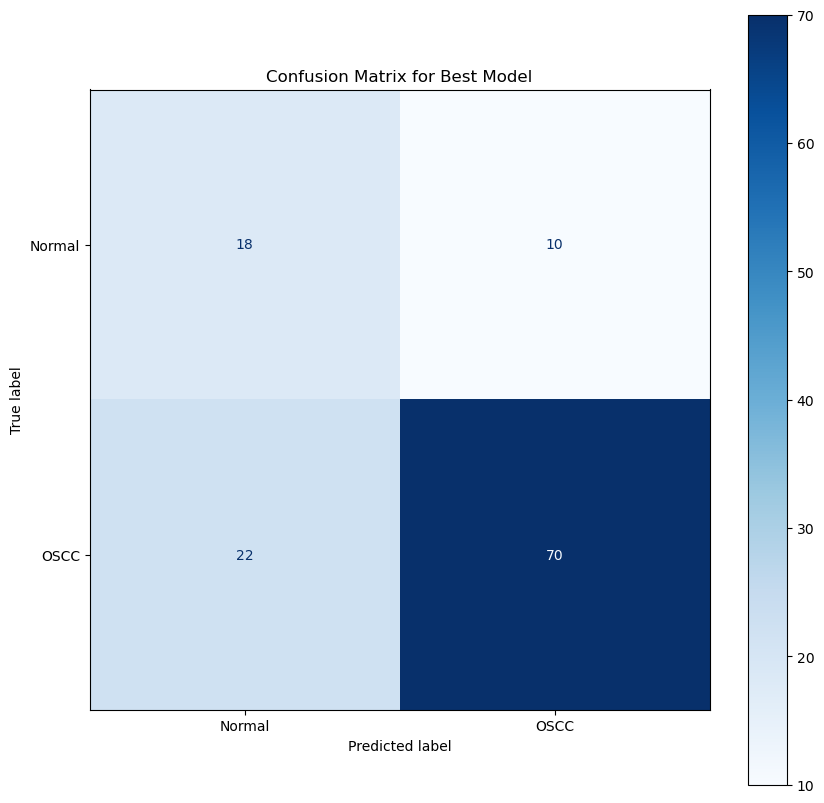

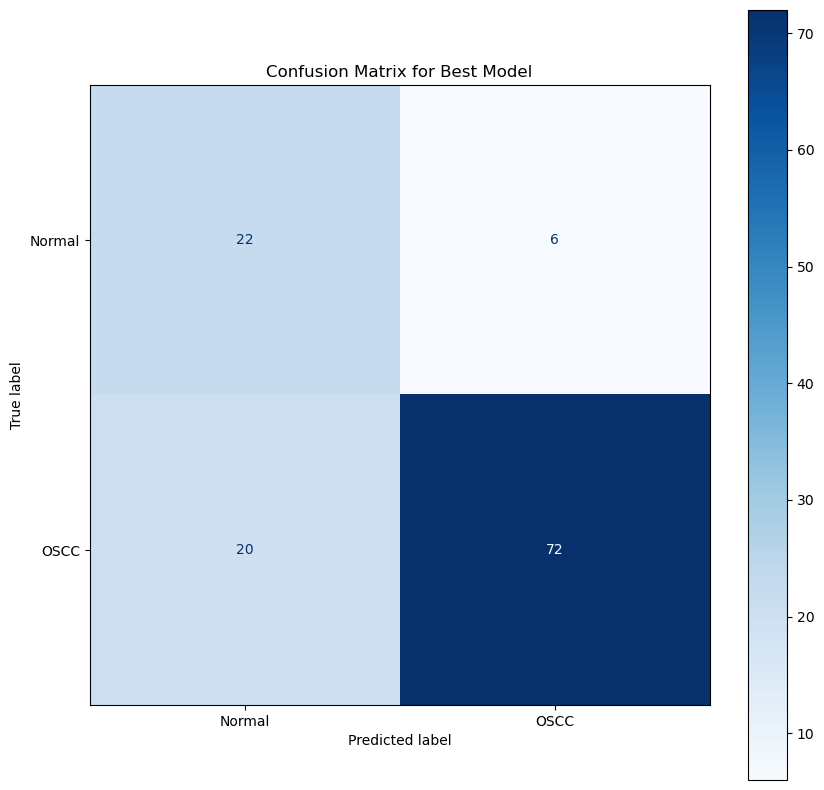

In [129]:
# run_cv_pipeline.py
# (Assuming standard imports: logging, time, datetime, Path, torch, etc. are in Cell 1)

# --- NEW IMPORT ---

def setup_logging(log_file):
    """Sets up the logging configuration."""
    # Ensure handlers are cleared for clean logging in subsequent runs
    for handler in logging.root.handlers[:]:
        logging.root.removeHandler(handler)
    logging.basicConfig(
        level=logging.INFO,
        format='%(asctime)s - %(levelname)s - %(message)s',
        handlers=[logging.FileHandler(log_file), logging.StreamHandler()]
    )

def main():
    """Main function to run the entire CV pipeline."""
    
    global cfg
    # --- 1. RECORD START TIME ---
    start_time = time.time()

    # 2. Setup run-specific output folder and logging
    run_timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
    model_name_cfg = cfg['model_params']['name']
    run_folder_name = f"{model_name_cfg}_{run_timestamp}"

    # Base output directory
    base_output_dir = Path(cfg['outputs']['base_dir'])
    run_folder_path = base_output_dir / run_folder_name
    run_folder_path.mkdir(parents=True, exist_ok=True)

    # Update all output paths in the config to point to the current run's folder
    for key, path_template in cfg['outputs'].items():
        if isinstance(path_template, str) and "{run_folder}" in path_template:
             cfg['outputs'][key] = path_template.format(run_folder=run_folder_path)

    setup_logging(cfg['outputs']['log_file'])
    logging.info("Configuration loaded and logging set up.")
    logging.info(f"All outputs for this run will be saved in: {run_folder_path}")

    # 3. Setup device
    device = "cuda" if torch.cuda.is_available() else "cpu"
    logging.info(f"Using device: {device}")

    # 4. Prepare Data
    logging.info("Starting data preparation...")
    train_dir_path = cfg['data']['train_dir']
    val_dir_path = cfg['data']['val_dir']

    train_loader, val_loader, class_names = prepare_data(
        train_dir=train_dir_path,
        valid_or_test_dir=val_dir_path,
        cfg=AUGMENTATION_CONFIG, 
        num_workers=AUGMENTATION_CONFIG['data']['num_workers']
    )

    logging.info(f"Data preparation complete. Found classes: {class_names}")

    # =================================================================
    # STAGE 1: FEATURE EXTRACTION (Base Frozen)
    # =================================================================
    logging.info("--- Initializing Model for Stage 1 ---")

    # A. Define Paths
    local_weights_dir = cfg['model_params']['local_weights_dir']
    local_weights_path = Path(local_weights_dir) / f"{model_name_cfg}.pth"

    # B. Load Model via Factory (Strict=False allows loading base weights into new head)
    # This handles all the "delete key" logic internally
    model = get_model(
        model_name=model_name_cfg,
        num_classes=len(class_names),
        weights_path=local_weights_path,
        device=device,
        strict_load=False 
    )
    logging.info(f"Model '{model_name_cfg}' initialized via Factory.")

    # C. Apply Freezing Strategy for Stage 1 (Freeze everything except head)
    logging.info("Freezing base layers for Feature Extraction...")
    
    # 1. Freeze EVERYTHING first
    for param in model.parameters():
        param.requires_grad = False
        
    # 2. Unfreeze ONLY the classifier/head
    # We dynamically find the head using the model structure
    head_found = False
    
    # Torchvision styles
    if hasattr(model, 'classifier'): # EfficientNet, MobileNet, ConvNeXt
        for param in model.classifier.parameters(): param.requires_grad = True
        head_found = True
    elif hasattr(model, 'fc'): # ResNet
        for param in model.fc.parameters(): param.requires_grad = True
        head_found = True
    elif hasattr(model, 'heads'): # ViT
        for param in model.heads.parameters(): param.requires_grad = True
        head_found = True
    elif hasattr(model, 'head'): # Swin, CoaT (TIMM)
        for param in model.head.parameters(): param.requires_grad = True
        head_found = True
        
    if not head_found:
        logging.warning("Could not auto-detect head to unfreeze. Please check model structure manually.")

    # 6. Initialize Loss & Optimizer
    loss_cfg = cfg['loss_function']
    if loss_cfg['name'] == "FocalLoss":
        loss_fn = FocalLoss(**loss_cfg['params'])
    else:
        loss_fn = torch.nn.CrossEntropyLoss()

    optimizer_name = cfg['train_params']['optimizer']
    learning_rate = cfg['train_params']['learning_rate']
    
    if optimizer_name.lower() == 'adamw':
        optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)
    else:
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

    # 7. Start Training Stage 1
    logging.info("--- Starting Stage 1 Training ---")
    results_stage1 = train(
        cfg=cfg,
        model=model,
        train_loader=train_loader,
        test_loader=val_loader,
        loss_fn=loss_fn,
        optimizer=optimizer,
        scheduler=None, # No scheduler for stage 1
        device=device,
        class_names=class_names
    )
    logging.info("Stage 1 complete.")

    save_report(results_stage1, cfg['outputs']['report_path'])
    plot_and_save_curves(results_stage1, cfg['outputs']['training_curves_plot_path'])

    # =================================================================
    # STAGE 2: FINE-TUNING
    # =================================================================
    logging.info("--- Starting Stage 2: Fine-Tuning ---")

    # 1. Reload Best Model from Stage 1
    # We reload to ensure we start from the best checkpoint, not the last epoch state
    best_model_path_stage1 = cfg['outputs']['model_path']
    
    model = get_model(
        model_name=model_name_cfg,
        num_classes=len(class_names),
        weights_path=best_model_path_stage1,
        device=device,
        strict_load=True # Strict=True because architecture matches exactly now
    )
    logging.info(f"Loaded best Stage 1 model from: {best_model_path_stage1}")

    # 2. Apply Unfreezing Strategy (Specific to model type)
    if model_name_cfg == 'efficientnet_b0':
        for param in model.features[-3:].parameters():
            param.requires_grad = True
        logging.info("Unfroze top 3 blocks of EfficientNet.")
        
    elif 'resnet' in model_name_cfg:
        for param in model.layer4.parameters():
            param.requires_grad = True
        logging.info("Unfroze layer4 of ResNet.")
        
    elif 'vit' in model_name_cfg:
        for param in model.encoder.layers[-2:].parameters():
            param.requires_grad = True
        logging.info("Unfroze top 2 encoder layers of ViT.")
        
    elif 'convnext' in model_name_cfg or 'swin' in model_name_cfg:
        for param in model.features[-1].parameters():
            param.requires_grad = True
        logging.info("Unfroze final stage of ConvNeXt/Swin.")

    elif model_name_cfg == "coat_lite_mini":
        # Unfreeze everything, then re-freeze patch embeddings (common strategy for CoaT)
        for param in model.parameters(): param.requires_grad = True
        for param in model.patch_embed1.parameters(): param.requires_grad = False
        logging.info("Unfroze CoaT layers (except patch embeddings).")

    else:
        # Generic fallback for unknown models: Unfreeze everything
        for param in model.parameters(): param.requires_grad = True
        logging.info(f"Unfroze all layers for {model_name_cfg}.")

    # 3. New Optimizer (Lower LR)
    finetune_lr = cfg['train_params'].get('finetune_learning_rate', 1e-4)
    optimizer = torch.optim.AdamW(model.parameters(), lr=finetune_lr)
    
    # 4. Scheduler (Optional)
    scheduler_cfg = cfg['train_params'].get('scheduler', {})
    scheduler = None
    if scheduler_cfg.get('name') == "CosineAnnealingLR":
        scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, **scheduler_cfg.get('params', {}))

    # 5. Update Config Paths for Stage 2 Outputs
    cfg['outputs']['model_path'] = cfg['outputs']['model_path_finetuned']
    cfg['outputs']['cm_plot_path'] = cfg['outputs']['cm_plot_path_finetuned']
    cfg['train_params']['epochs'] = cfg['train_params'].get('finetune_epochs', 3)

    # 6. Start Training Stage 2
    results_stage2 = train(
        cfg=cfg,
        model=model,
        train_loader=train_loader,
        test_loader=val_loader,
        loss_fn=loss_fn,
        optimizer=optimizer,
        scheduler=scheduler,
        device=device,
        class_names=class_names
    )
    logging.info("Stage 2 complete.")

    save_report(results_stage2, cfg['outputs']['report_path_finetuned'])
    plot_and_save_curves(results_stage2, cfg['outputs']['training_curves_plot_path_finetuned'])
    
    # --- 3. FINALIZE ---
    end_time = time.time()
    duration = end_time - start_time
    minutes, seconds = int(duration // 60), int(duration % 60)
    
    logging.info("="*50)
    logging.info(f"PIPELINE EXECUTION COMPLETE. Duration: {minutes}m {seconds}s")
    logging.info(f"All artifacts saved in: {run_folder_path}")
    logging.info("="*50)

if __name__ == "__main__":
    main()

# Run

2026-02-05 14:22:43,798 - INFO - Configuration loaded and logging set up.
2026-02-05 14:22:43,800 - INFO - All outputs for this run will be saved in: outputs\efficientnet_b0_20260205_142243
2026-02-05 14:22:45,510 - INFO - Using device: cuda
2026-02-05 14:22:45,511 - INFO - Starting data preparation...
2026-02-05 14:22:45,827 - INFO - Using training data from: data/histopathologic-oral-cancer/train
2026-02-05 14:22:45,828 - INFO - Using validation data from: data/histopathologic-oral-cancer/val
2026-02-05 14:22:45,828 - INFO - Data preparation complete. Found classes: ['Normal', 'OSCC']
2026-02-05 14:22:45,829 - INFO - Initializing model: efficientnet_b0
C:\Users\User\AppData\Local\Temp\ipykernel_19532\3742288768.py:141: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.c

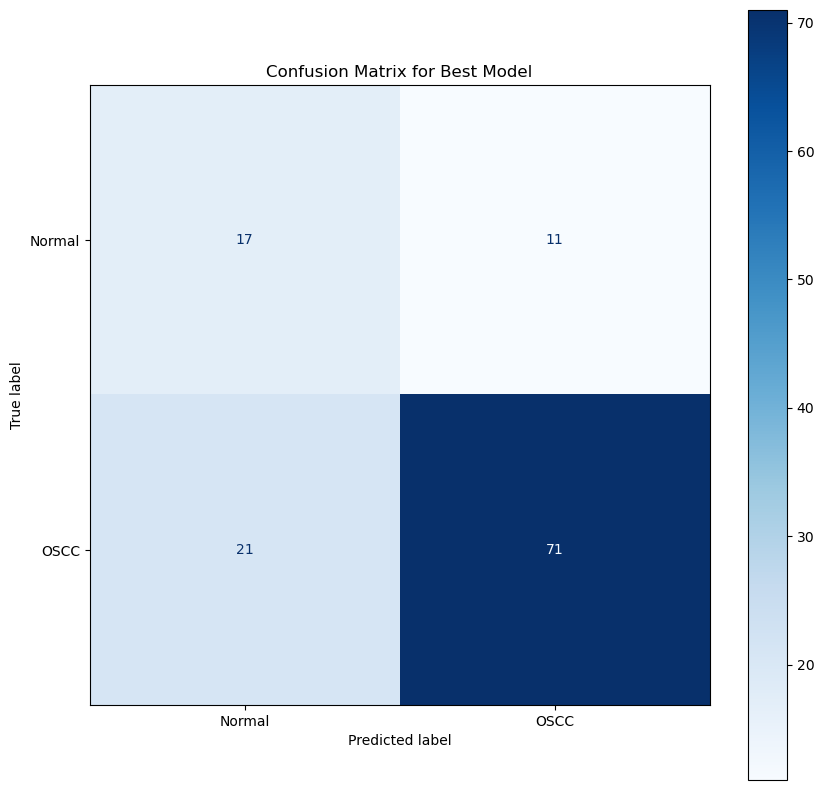

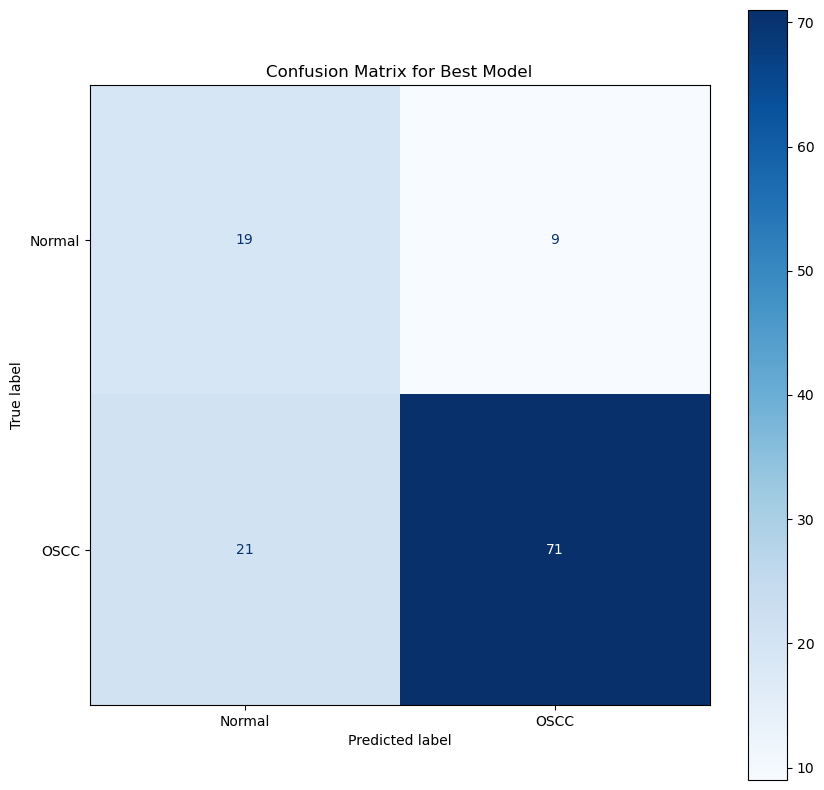

In [20]:
# Run the training
if __name__ == "__main__":
    main()
    # wandb.finish() 

# Model Loading

In [ ]:
import torch
import torch.nn as nn
from torchvision import models
import timm
from pathlib import Path
import logging

def get_model(model_name, num_classes, weights_path=None, device='c', strict_load=True):
    """
    Unified model loader for Training, Prediction, and Explanation.
    
    Args:
        model_name (str): Name of the model (e.g., 'efficientnet_b0', 'coat_lite_mini').
        num_classes (int): Number of output classes.
        weights_path (str or Path, optional): Path to .pth file to load.
        device (str): 'cuda' or 'cpu'.
        strict_load (bool): If True, structure must match weights exactly (for Inference/Finetuning).
                            If False, ignores head mismatches (for loading Pretrained Base).
    """
    model = None
    print(f"[Model Factory] Initializing {model_name}...")

    # --- A. ARCHITECTURE DEFINITION ---
    # 1. EfficientNet (Ensures Dropout consistency)
    if model_name == 'efficientnet_b0':
        model = models.efficientnet_b0(weights=None)
        # Replicate the exact structure used in Training Stage 1
        num_ftrs = model.classifier[1].in_features
        model.classifier = nn.Sequential(
            nn.Dropout(p=0.2, inplace=True),
            nn.Linear(in_features=num_ftrs, out_features=num_classes)
        )

    # 2. ResNet Family
    elif model_name in ['resnet18', 'resnet50']:
        model = getattr(models, model_name)(weights=None)
        num_ftrs = model.fc.in_features
        model.fc = nn.Linear(num_ftrs, num_classes)

    # 3. Vision Transformer (Torchvision)
    elif model_name == 'vit_b_16':
        model = models.vit_b_16(weights=None)
        num_ftrs = model.heads.head.in_features
        model.heads.head = nn.Linear(num_ftrs, num_classes)

    # 4. Swin Transformer (Torchvision)
    elif model_name == 'swin_t':
        model = models.swin_t(weights=None)
        num_ftrs = model.head.in_features
        model.head = nn.Linear(num_ftrs, num_classes)

    # 5. ConvNeXt (Torchvision)
    elif model_name == 'convnext_tiny':
        model = models.convnext_tiny(weights=None)
        num_ftrs = model.classifier[2].in_features
        model.classifier[2] = nn.Linear(num_ftrs, num_classes)

    # 6. TIMM Models (CoaT, LeViT, etc.)
    else:
        # TIMM handles the classifier head creation automatically with num_classes
        try:
            model = timm.create_model(model_name, pretrained=False, num_classes=num_classes)
        except Exception as e:
            raise ValueError(f"Model '{model_name}' not found in Torchvision or TIMM. Error: {e}")

    # --- B. WEIGHT LOADING ---
    if weights_path:
        weights_path = Path(weights_path)
        if not weights_path.exists():
            raise FileNotFoundError(f"Weights not found at {weights_path}")
        
        print(f"[Model Factory] Loading weights from {weights_path.name}...")
        
        # 1. Load Dictionary
        checkpoint = torch.load(weights_path, map_location=device, weights_only=True)
        
        # 2. Unwrap 'state_dict' if it was saved by Lightning or a custom wrapper
        if isinstance(checkpoint, dict) and 'state_dict' in checkpoint:
            state_dict = checkpoint['state_dict']
        else:
            state_dict = checkpoint

        # 3. Smart Loading Logic
        if strict_load:
            # Case: Inference or Stage 2 (Fine-tuning) -> Architecture matches weights exactly
            model.load_state_dict(state_dict, strict=True)
        else:
            # Case: Training Stage 1 -> Loading generic pretrained weights into a custom head model
            # Remove head/classifier keys that don't match our new num_classes
            
            # Identify the likely classifier key based on model type
            classifier_keys = ['classifier', 'fc', 'head', 'heads'] 
            keys_to_remove = []
            
            for key in state_dict.keys():
                for clf_name in classifier_keys:
                    # Check if this key belongs to a classifier layer (e.g., "head.weight", "fc.bias")
                    if key.startswith(clf_name):
                        keys_to_remove.append(key)
            
            # Remove them
            for key in set(keys_to_remove): # set() to avoid duplicates
                del state_dict[key]
                
            print(f"[Model Factory] Non-strict load. Ignored keys: {list(set(keys_to_remove))[:3]}...")
            model.load_state_dict(state_dict, strict=False)

    model = model.to(device)
    return model

# Predict


### coat lite

In [124]:
# Manually set arguments, like argparse would
model_path_finetuned = 'outputs/coat_lite_mini_20260122_072857/best_model_finetuned.pth'
#coat_lite_mini_20260204_181400
model_name_finetuned = 'coat_lite_mini'
#coat_lite_mini

### efficient net

In [126]:
# Manually set arguments, like argparse would
model_path_finetuned = 'outputs/efficientnet_b0_20260205_142243/best_model_finetuned.pth'
#coat_lite_mini_20260204_181400
model_name_finetuned = 'efficientnet_b0'
#coat_lite_mini

## Create Submission


In [38]:
# Contents of predict.py
# (Imports are already in Cell 1)
# (dataloader_factory functions are in Cell 7)
# (AUGMENTATION_CONFIG is in Cell 2)

def predict(args):
    """Generates predictions and creates a submission file."""
    # Load configuration
    # with open(args.config, "r") as f:
    #     cfg = yaml.safe_load(f)
    global cfg

    # Setup logging and device
    logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')
    device = "cuda" if torch.cuda.is_available() else "cpu"
    logging.info(f"Using device: {device}")

    # Get class names from the TRAINING data directory
    train_dir = Path(cfg['data']['train_dir'])
    class_names = datasets.ImageFolder(root=train_dir).classes
    logging.info(f"Loaded class names for mapping: {class_names}")

    # Initialize Model Architecture
    model_name = cfg['model_params']['name']
    logging.info(f"Initializing model architecture: {model_name}")

    # Note: This block is simplified. For full model support,
    # you should use the dynamic model creation logic from your run_cv_pipeline.py
    if model_name == "efficientnet_b0":
        model = models.efficientnet_b0(weights=None)
        num_ftrs = model.classifier[1].in_features
        model.classifier[1] = nn.Linear(in_features=num_ftrs, out_features=len(class_names))
    elif model_name == "resnet18":
        model = models.resnet18(weights=None)
        num_ftrs = model.fc.in_features
        model.fc = nn.Linear(num_ftrs, len(class_names))
    elif model_name == "coat_lite_mini":
        model =timm.create_model(model_name, pretrained=False, num_classes=len(class_names))
    else:
        # This will need to be expanded to support your timm models
        raise ValueError(f"Model '{model_name}' is not supported in this script.")

    # Load the trained weights
    model_path = Path(args.model_path)
    # 2. Add weights_only=True for safety
    model.load_state_dict(torch.load(model_path, map_location=device, weights_only=True))
    model.to(device)
    model.eval()
    logging.info(f"Loaded trained model weights from {model_path}")

    # 3. Create the submission DataLoader using the correct function and arguments
    unlabeled_images_path = cfg['data']['test_dir']
    logging.info(f"Loading unlabeled data from: {unlabeled_images_path}")
    # submission_loader = dataloader_factory.create_submission_dataloader(
    submission_loader = create_submission_dataloader(
        images_dir=unlabeled_images_path,
        cfg=AUGMENTATION_CONFIG
    )

    # Generate Predictions
    logging.info("Generating predictions...")
    image_ids = []
    predictions = []
    with torch.inference_mode():
        # 4. Correctly unpack the THREE items from the dataloader
        for images, _, ids in tqdm(submission_loader, desc="Predicting"):
            images = images.to(device)
            outputs = model(images)
            _, preds_indices = torch.max(outputs, 1)
            predicted_labels = [class_names[p] for p in preds_indices.cpu().numpy()]
            image_ids.extend(ids)
            predictions.extend(predicted_labels)

    # Create and Save Submission File
    submission_df = pd.DataFrame({'id': image_ids, 'predict': predictions})
    submission_path = model_path.parent / "submission.csv" # Save in the same run folder
    submission_df.to_csv(submission_path, index=False)
    logging.info(f"Submission file created at: {submission_path}")
    print("\nSubmission file head:")
    print(submission_df.head())

In [ ]:
class PredictArgs:
    model_path = model_path_finetuned # <-- !!! SET THIS !!!
    # config = cfg # This isn't read, but good to show

# --- Run this cell to generate submission.csv ---
if not Path(PredictArgs.model_path).exists():
    print(f"Error: Model path not found. Please update 'PredictArgs.model_path' in this cell.")
else:
    predict(PredictArgs)

## Explain

In [120]:
print("Model path:", model_path_finetuned)
print("Model name:", model_name_finetuned)


Model path: outputs/efficientnet_b0_20260205_142243/best_model_finetuned.pth
Model name: efficientnet_b0


In [113]:
example_image = "data\\histopathologic-oral-cancer\\test\\OSCC\\OSCC_100x_20.jpg"

### IG & GC & OC with model options
Integrated Cam, GradCam, Occlusion

Device: cuda
Loading architecture: efficientnet_b0...
[Model Factory] Initializing efficientnet_b0...
[Model Factory] Loading weights from best_model_finetuned.pth...
Grad-CAM Target Layer: Conv2dNormActivation(
  (0): Conv2d(320, 1280, kernel_size=(1, 1), stride=(1, 1), bias=False)
  (1): BatchNorm2d(1280, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): SiLU(inplace=True)
)
Prediction: Normal (0.5916)
Running Integrated Gradients...
Running Grad-CAM...
Running Occlusion...


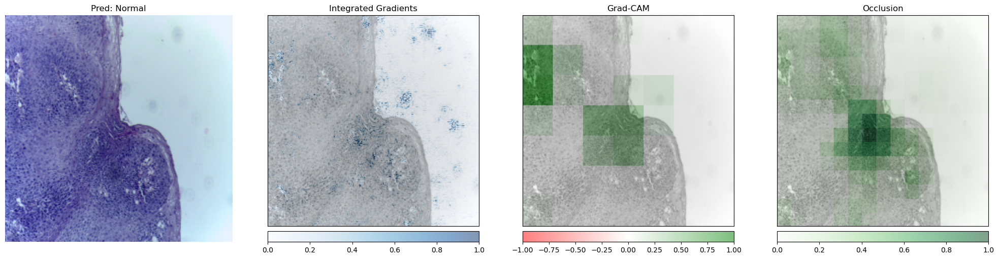

In [127]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from pathlib import Path
from torchvision import transforms, models
import timm

# Captum Imports
from captum.attr import IntegratedGradients, LayerGradCam, LayerAttribution, Occlusion
from captum.attr import visualization as viz

# --- 1. CONFIGURATION (Use your defined variables) ---
# Ensure these match your previous cell
# model_path_finetuned = 'outputs/.../best_model_finetuned.pth'
# model_name_finetuned = 'coat_lite_mini' (or 'mobilenet_v2', 'efficientnet_b0', etc.)

# You need to define class names manually or load them
# Example: ['Normal', 'OSCC']
class_names = ['Normal', 'OSCC'] 

def full_explanation_pipeline(model_name, model_path, image_path, classes):
    device = "cuda" if torch.cuda.is_available() else "cpu"
    print(f"Device: {device}")
    
    # --- 2. LOAD MODEL (Robust Logic) ---
    print(f"Loading architecture: {model_name}...")
    
    try:
        model = get_model(
            model_name=model_name,
            num_classes=len(classes),
            weights_path=model_path,
            device=device,
            strict_load=True
        )
        model.eval()
    except Exception as e:
        print(f"[CRITICAL ERROR] {e}")
        return

    # --- 3. AUTO-DETECT TARGET LAYER (Fixes the "Spatial Dimension" Error) ---
    # We need a layer that outputs (Batch, Channel, Height, Width).
    # Linear layers output (Batch, Features), which causes the crash.
    target_layer = None
    
    # Priority 1: Known spatial layers for common models
    if "mobilenet" in model_name or "efficientnet" in model_name:
        target_layer = model.features[-1] # Usually the last Conv Block
    elif "resnet" in model_name:
        target_layer = model.layer4[-1]   # Last Residual Block
    elif "coat" in model_name:
        try:
            # We target the 'cpe.proj' (Convolutional Positional Encoding -> Projection)
            # inside the last block. This is a real Conv2d layer with spatial output!
            target_layer = model.serial_blocks4[-1].cpe.proj
            print("Grad-CAM Target: serial_blocks4[-1].cpe.proj (Spatial Conv Layer)")
        except AttributeError:
            # Fallback if specific path doesn't exist
            print("Could not find specific CoaT layer, searching for last Conv2d...")
            for name, module in reversed(list(model.named_modules())):
                if isinstance(module, nn.Conv2d):
                    target_layer = module
                    break

    # Priority 2: Fallback (Search for last Conv2d)
    if target_layer is None:
        for name, module in reversed(list(model.named_modules())):
            if isinstance(module, nn.Conv2d):
                target_layer = module
                break
    
    print(f"Grad-CAM Target Layer: {target_layer}")

    # --- 4. PREDICT & EXPLAIN ---
    image_size = 224
    transform = transforms.Compose([
        transforms.Resize((image_size, image_size)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ])
    
    img = Image.open(image_path).convert("RGB")
    input_tensor = transform(img).unsqueeze(0).to(device)
    
    # Predict
    output = model(input_tensor)
    probs = torch.nn.functional.softmax(output, dim=1)
    score, idx = torch.topk(probs, 1)
    pred_class = classes[idx.item()]
    print(f"Prediction: {pred_class} ({score.item():.4f})")

    # XAI 1: Integrated Gradients
    print("Running Integrated Gradients...")
    ig = IntegratedGradients(model)
    attr_ig = ig.attribute(input_tensor, target=idx.item(), n_steps=30)
    
    # XAI 2: Grad-CAM
    attr_gc_up = None
    if target_layer:
        print("Running Grad-CAM...")
        lgc = LayerGradCam(model, target_layer)
        try:
            attr_gc = lgc.attribute(input_tensor, target=idx.item(), relu_attributions=True)
            # Only interpolate if we actually have spatial data (4 dims)
            if attr_gc.dim() == 4:
                attr_gc_up = LayerAttribution.interpolate(attr_gc, (image_size, image_size))
            else:
                print(f"Skipping Grad-CAM plot: Output is flat {attr_gc.shape}, expected spatial.")
        except Exception as e:
            print(f"Grad-CAM skipped: {e}")

    # XAI 3: Occlusion
    print("Running Occlusion...")
    occlusion = Occlusion(model)
    attr_occ = occlusion.attribute(input_tensor, strides=(3, 15, 15), target=idx.item(), sliding_window_shapes=(3, 30, 30), baselines=0)

    # --- 5. VISUALIZE ---
    img_np = transform(img).permute(1, 2, 0).numpy()
    img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min()) # Normalize 0-1
    
   # Helper to safely convert ANY tensor to (H, W, 1) for plotting
    def safe_reshape(attr_tensor):
        # Detach and move to CPU numpy
        arr = attr_tensor.detach().cpu().numpy()
        # Remove batch dimension if present
        if arr.ndim == 4: arr = arr.squeeze(0)
        # Move channels to end
        if arr.shape[0] in [1, 3]: 
            arr = np.transpose(arr, (1, 2, 0))
        # Ensure it is 3D (H, W, 1) if it became 2D
        if arr.ndim == 2:
            arr = arr[:, :, np.newaxis]
        return arr

    num_plots = 4 if attr_gc_up is not None else 3
    fig, ax = plt.subplots(1, num_plots, figsize=(5*num_plots, 5))
    
    # Plot 1: Original
    ax[0].imshow(img_np)
    ax[0].set_title(f"Pred: {pred_class}")
    ax[0].axis('off')
    
    # Plot 2: IG
    viz.visualize_image_attr(safe_reshape(attr_ig), img_np, method="blended_heat_map", sign="absolute_value", show_colorbar=True, plt_fig_axis=(fig, ax[1]), use_pyplot=False)
    ax[1].set_title("Integrated Gradients")
    
    curr = 2
    # Plot 3: Grad-CAM
    if attr_gc_up is not None:
        # Use safe_reshape here to prevent the crash
        viz.visualize_image_attr(safe_reshape(attr_gc_up), img_np, method="blended_heat_map", sign="all", show_colorbar=True, plt_fig_axis=(fig, ax[curr]), use_pyplot=False)
        ax[curr].set_title("Grad-CAM")
        curr += 1

    # Plot 4: Occlusion
    viz.visualize_image_attr(safe_reshape(attr_occ), img_np, method="blended_heat_map", sign="positive", show_colorbar=True, plt_fig_axis=(fig, ax[curr]), use_pyplot=False)
    ax[curr].set_title("Occlusion")
    
    plt.tight_layout()
    plt.show()


# --- EXECUTE ---
# Replace 'test_image.jpg' with your actual image path
full_explanation_pipeline(model_name_finetuned, model_path_finetuned, example_image, class_names)